In [40]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal as sps
from scipy.signal import find_peaks, butter, filtfilt
from scipy.fft import ifft, fft,rfft, irfft, rfftfreq
import pandas as pd

## Assignment 1

## A) Generate a sine wave, add noise to it, and then perform convolution with a smoothing filter to reduce noise. Make your code general, so that it takes the filter from the user.

Enter the filter (average): average


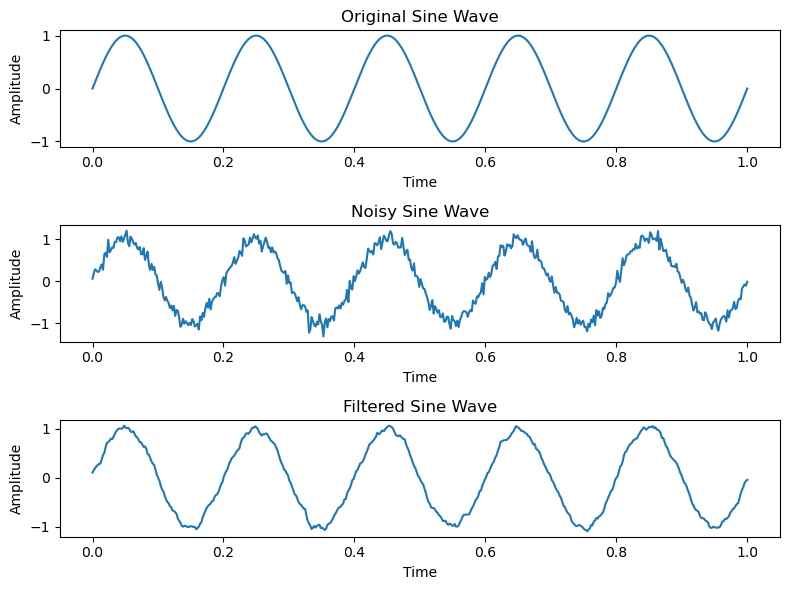

In [49]:
def generate_noisy_signal(N=1, samples=100, F=5, LEVEL=0.1):
    time = np.linspace(0, 1, samples)
    sine = np.sin(N * np.pi * F * time)
    noise = np.random.randn(samples)
    return sine + LEVEL * noise, sine, time

def apply_filter(noisy_signal, filter_type, filter_params):
    if filter_type == 'average':
        filter = np.ones(filter_params) / filter_params
    else:
        raise ValueError("Invalid filter type")

    return np.convolve(noisy_signal, filter, mode="same")

def main():
    filter_type = input("Enter the filter (average): ")

    if filter_type == 'average':
        filter_params = 5
    else:
        raise ValueError("Invalid filter type")

    noisy_signal, sine_signal, time = generate_noisy_signal(N=5, samples=500, F=2, LEVEL=0.1)

    filtered_signal = apply_filter(noisy_signal, filter_type, filter_params)

    plt.figure(figsize=(8, 6))
    plt.subplot(3, 1, 1)
    plt.plot(time, sine_signal, label='Original Sine Wave')
    plt.xlabel('Time')
    plt.ylabel('Amplitude')
    plt.title('Original Sine Wave')

    plt.subplot(3, 1, 2)
    plt.plot(time, noisy_signal, label='Noisy Signal')
    plt.xlabel('Time')
    plt.ylabel('Amplitude')
    plt.title('Noisy Sine Wave')

    plt.subplot(3, 1, 3)
    plt.plot(time, filtered_signal, label='Filtered Signal')
    plt.xlabel('Time')
    plt.ylabel('Amplitude')
    plt.title('Filtered Sine Wave')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    main()

## B) For the given ECG signals  compute and show the location of the R peak.

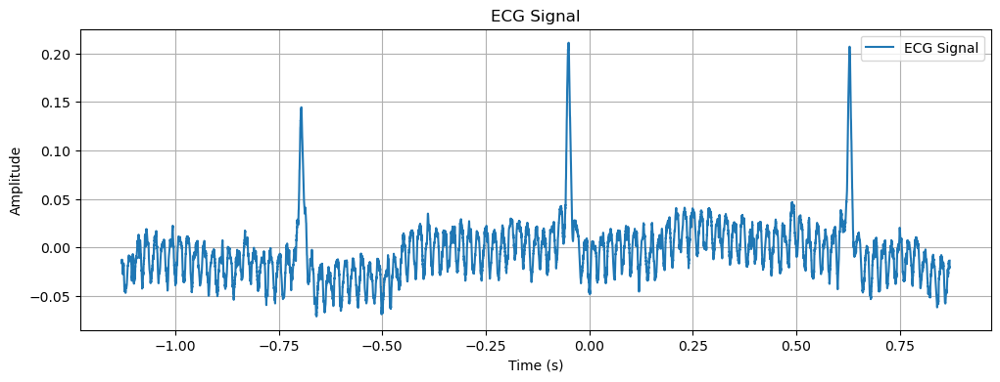

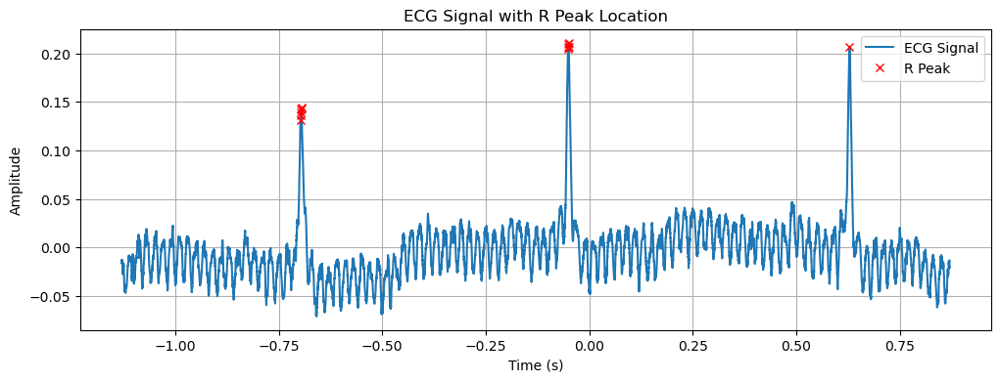

In [50]:
# Load the ECG signal
ecg_table = pd.read_csv("/home/nalin/Downloads/ecg(1).csv")
ecg = ecg_table['Channel 1 (V)']
time = ecg_table['Time (s)']

# Plot simple ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Compute and show the location of the R peak
peaks, _ = find_peaks(ecg, height=0.6 * np.max(ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='ECG Signal')
plt.plot(time[peaks], ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()

In [51]:
ecg_table

,Time (s),Channel 1 (V)
0,-1.12925,-0.015717
1,-1.12900,-0.013341
2,-1.12875,-0.015038
3,-1.12850,-0.012662
4,-1.12825,-0.015378
...,...,...
7995,0.86950,-0.019451
7996,0.86975,-0.021828
7997,0.87000,-0.018093
7998,0.87025,-0.018093


## C) Add noise to the ECG signal, and filter in the frequency domain such that the R peak is largely preserved.

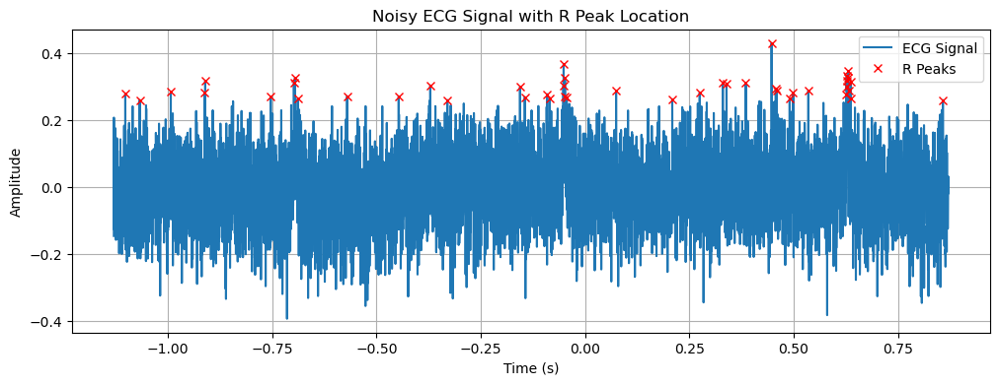

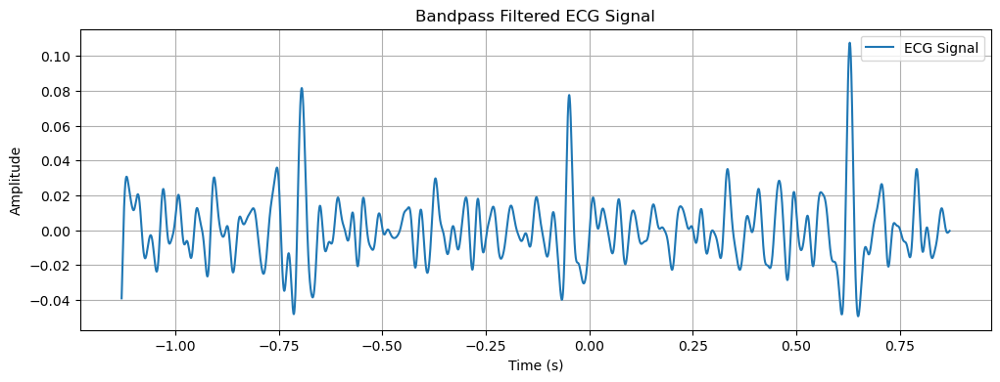

/home/nalin/anaconda3/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


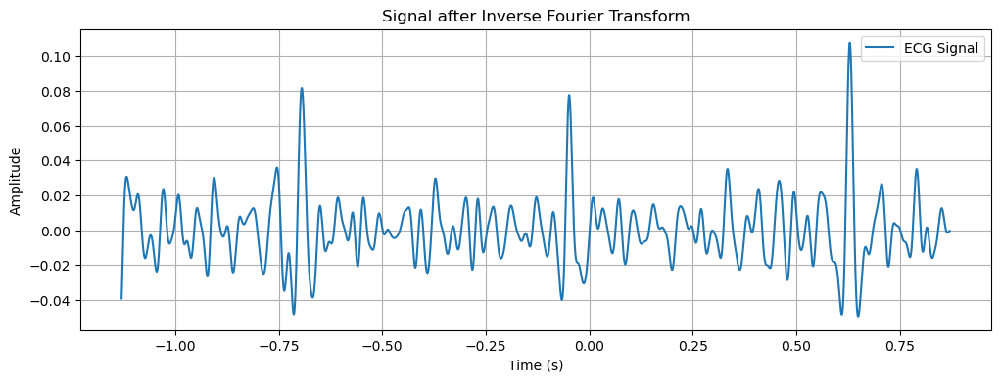

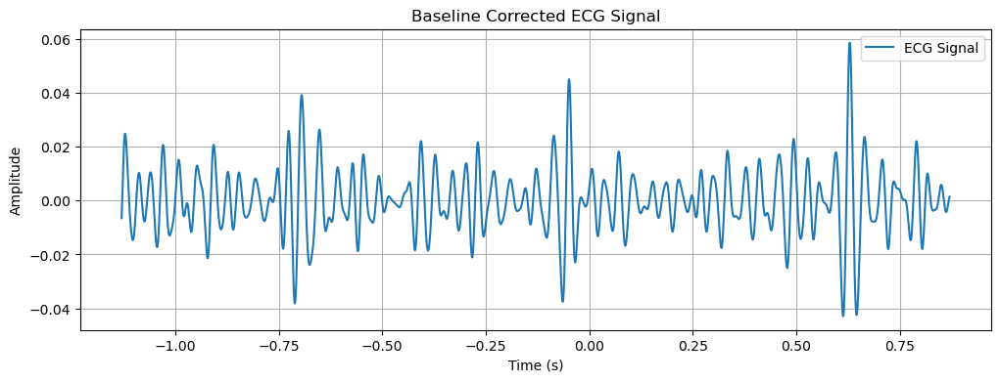

/home/nalin/anaconda3/lib/python3.9/site-packages/scipy/signal/_peak_finding.py:266: ComplexWarning: Casting complex values to real discards the imaginary part
  value = np.asarray(value, order='C', dtype=np.float64)
/home/nalin/anaconda3/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


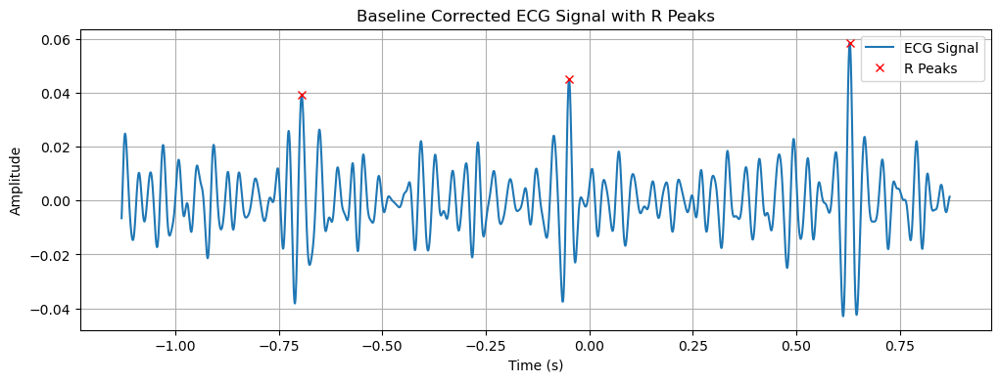

In [52]:
# Add noise to the ECG signal
noise_level = 0.1
noisy_ecg = ecg + np.random.normal(0, noise_level, len(ecg))


def bandpass_filter(signal, low_cut, high_cut, Fs):
    Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
    b, a = butter(N=3, Wn=Bw, btype='band')
    return filtfilt(b, a, signal)

def baseline_correction(signal, window_size):
    b, a = butter(N=5, Wn=0.01, btype='high')
    return filtfilt(b, a, signal)

def plot_signal(time, signal, peaks, title):
    plt.figure(figsize=(12, 4))
    plt.plot(time, signal, label='ECG Signal')
    if peaks is not None:
        plt.plot(time[peaks], signal[peaks], 'x', color='red', label='R Peaks')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.show()


# Compute and show the location of the R peak in the noisy ECG signal
peaks, _ = find_peaks(noisy_ecg, height=0.6* np.max(noisy_ecg))
plot_signal(time, noisy_ecg, peaks, 'Noisy ECG Signal with R Peak Location')

# Bandpass filtering
bandpass_filtered_ecg = bandpass_filter(noisy_ecg, low_cut=10, high_cut=40, Fs=1/(time[1]-time[0]))
plot_signal(time, bandpass_filtered_ecg, None, 'Bandpass Filtered ECG Signal')

# Inverse Fourier Transform
inverse_fft_filtered_ecg = ifft(fft(bandpass_filtered_ecg))
plot_signal(time, inverse_fft_filtered_ecg, None, 'Signal after Inverse Fourier Transform')

# Base-line correction
baseline_corrected_ecg = baseline_correction(inverse_fft_filtered_ecg, window_size=5)
plot_signal(time, baseline_corrected_ecg, None, 'Baseline Corrected ECG Signal')

# Find R Peaks
peaks_corrected, _ = find_peaks(x=baseline_corrected_ecg, prominence=0.9 * np.max(baseline_corrected_ecg))
plot_signal(time, baseline_corrected_ecg, peaks_corrected, 'Baseline Corrected ECG Signal with R Peaks')


## Assignment 2

## Given EEG data files, filter the signals to get the output in the frequency ranges as

## 1) Delta

## 2) Theta

## 3) Alpha

## 4) Beta

## Plot both the time and frequency domains of the input and output signals in each case. Also plot the filters that you used in the frequency domain.


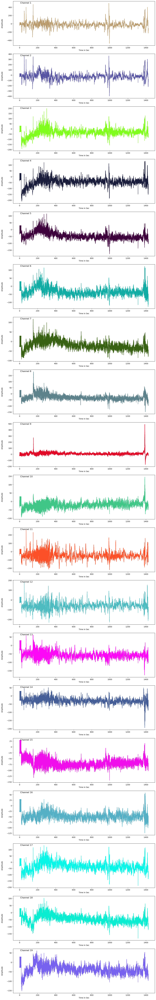

In [53]:

# Load EEG data
eeg = np.load('/home/nalin/Downloads/eeg_data_files-20240411/66_00002251_none_montage_False.npy')
eeg_array = np.asarray(eeg)

# Get number of channels and time points
num_channels, num_time_points = eeg_array.shape
time = np.arange(num_time_points) / 100.0

# Plot EEG data for each channel
fig, axs = plt.subplots(num_channels, 1, figsize=(12, 4 * num_channels))
for channel in range(num_channels):
    axs[channel].plot(time, eeg_array[channel, :], c=np.random.rand(3))
    axs[channel].set_ylabel(f'Amplitude', labelpad=20)
    axs[channel].set_xlabel('Time in Sec')
    axs[channel].text(0.05, 0.95, f'Channel {channel + 1}', transform=axs[channel].transAxes, fontsize=12)
plt.tight_layout()
plt.show()

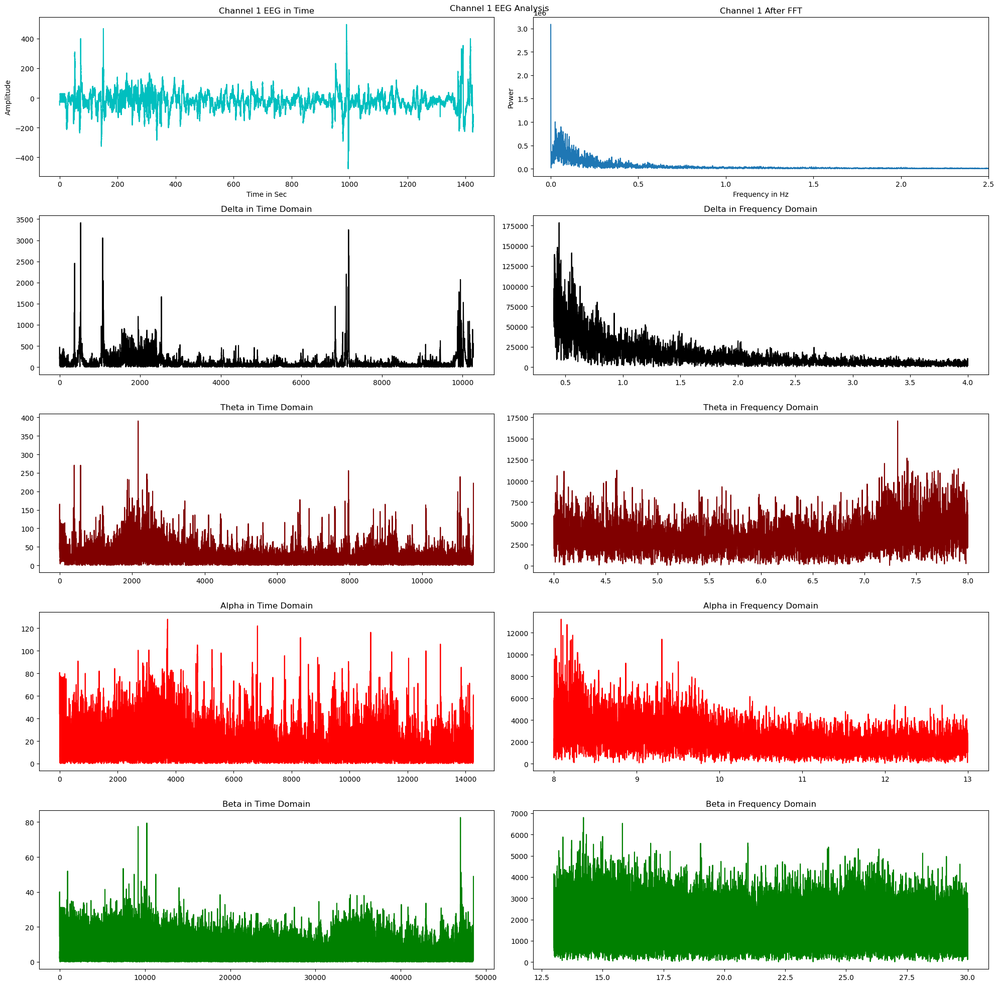

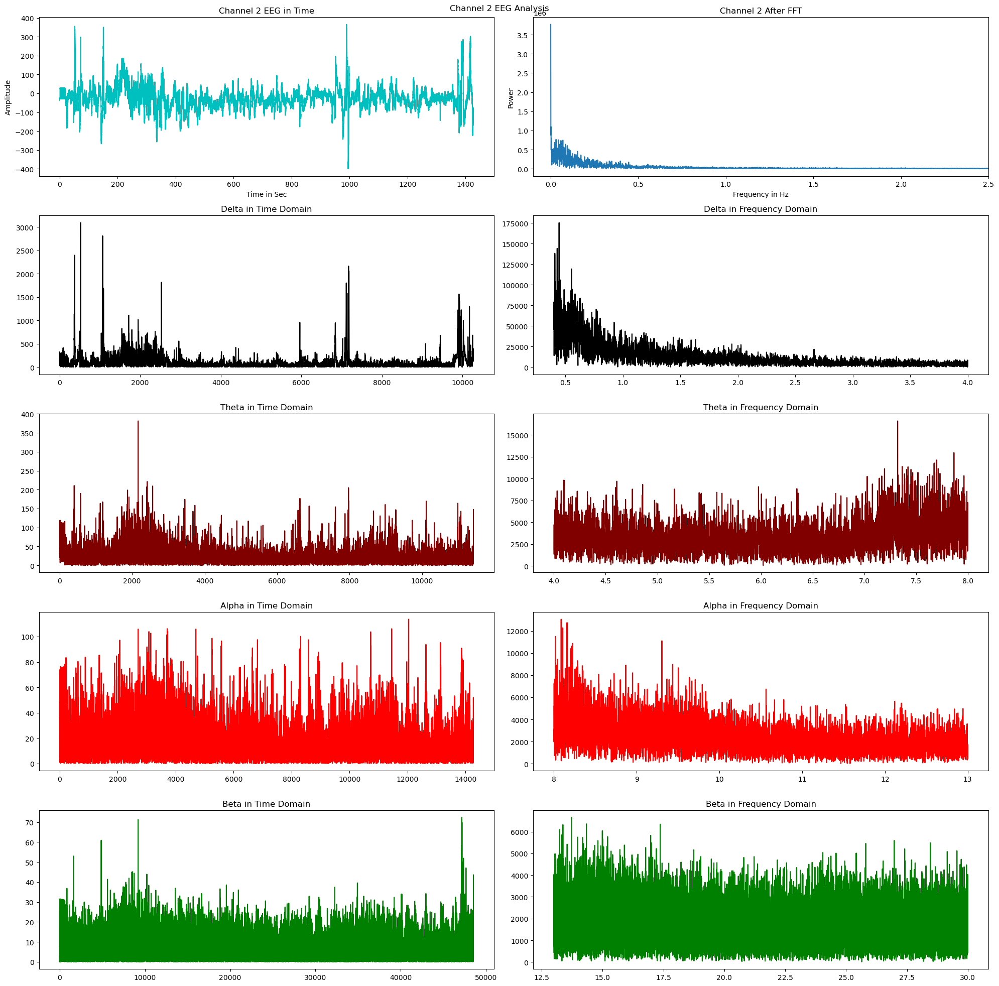

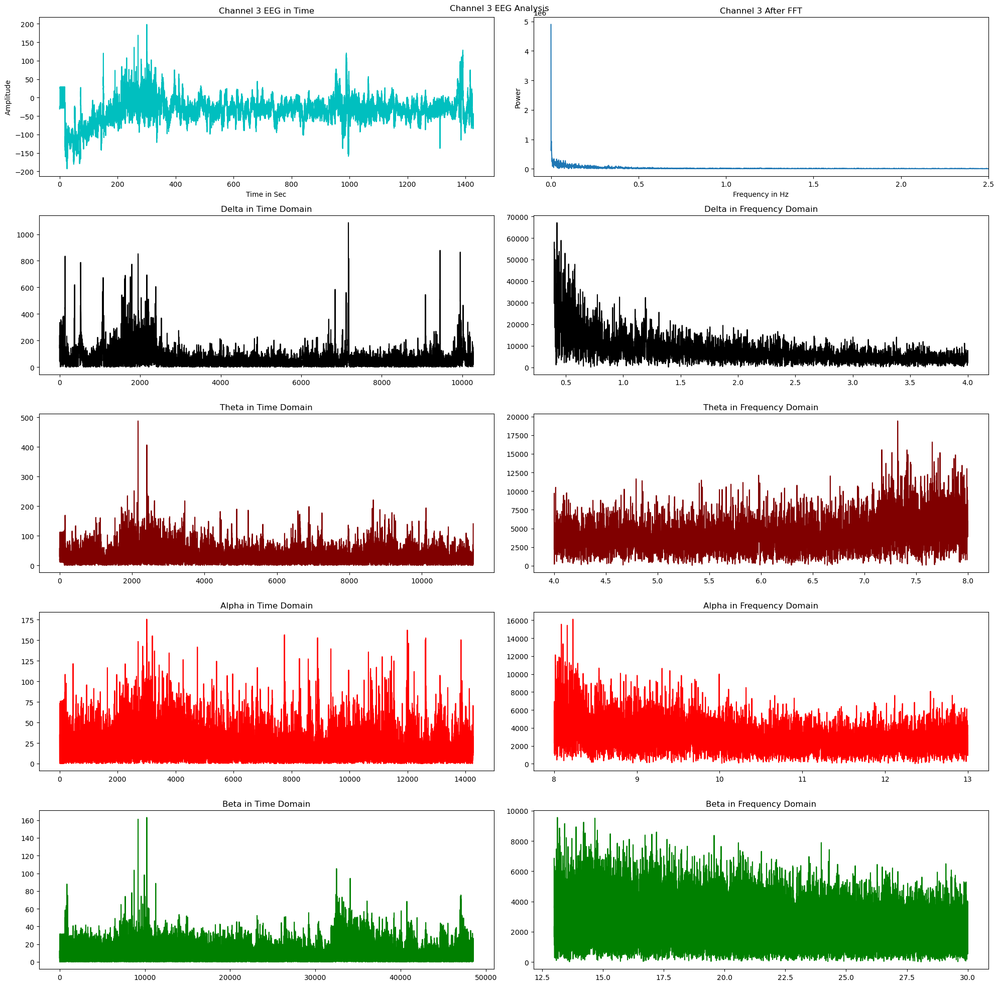

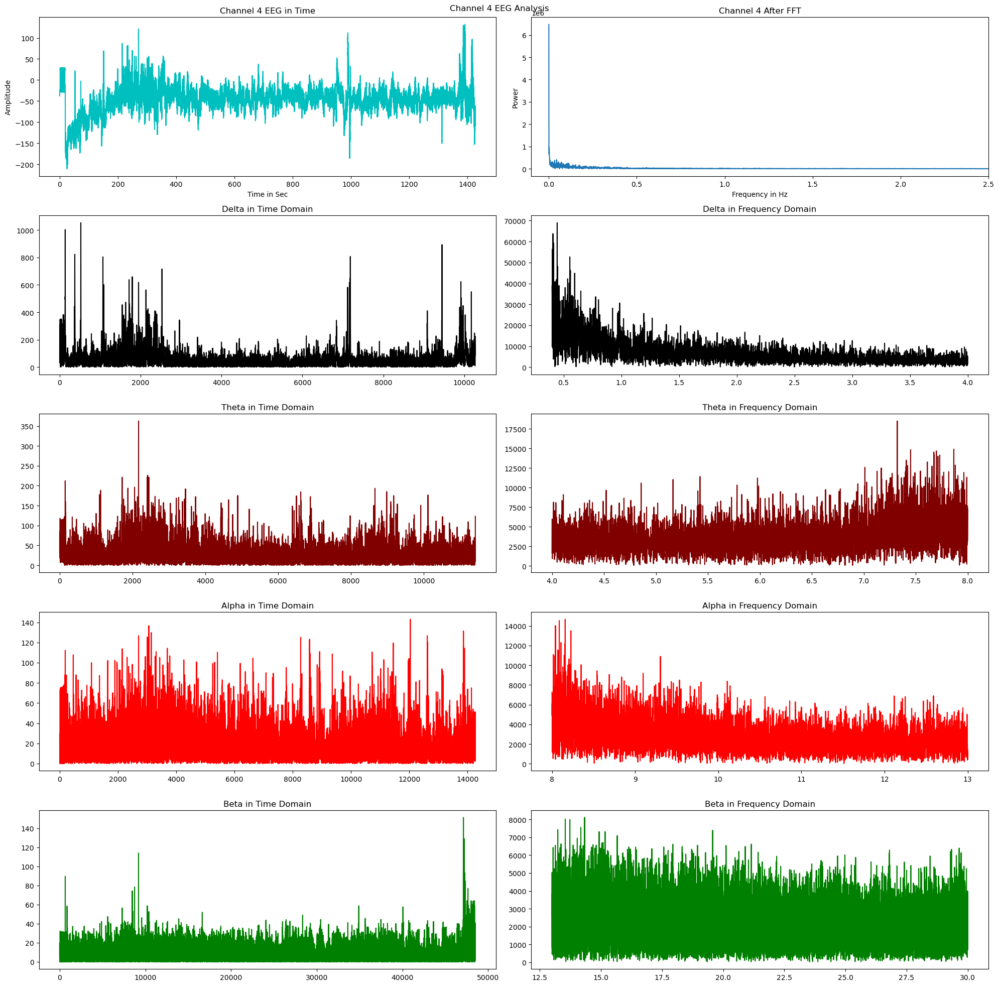

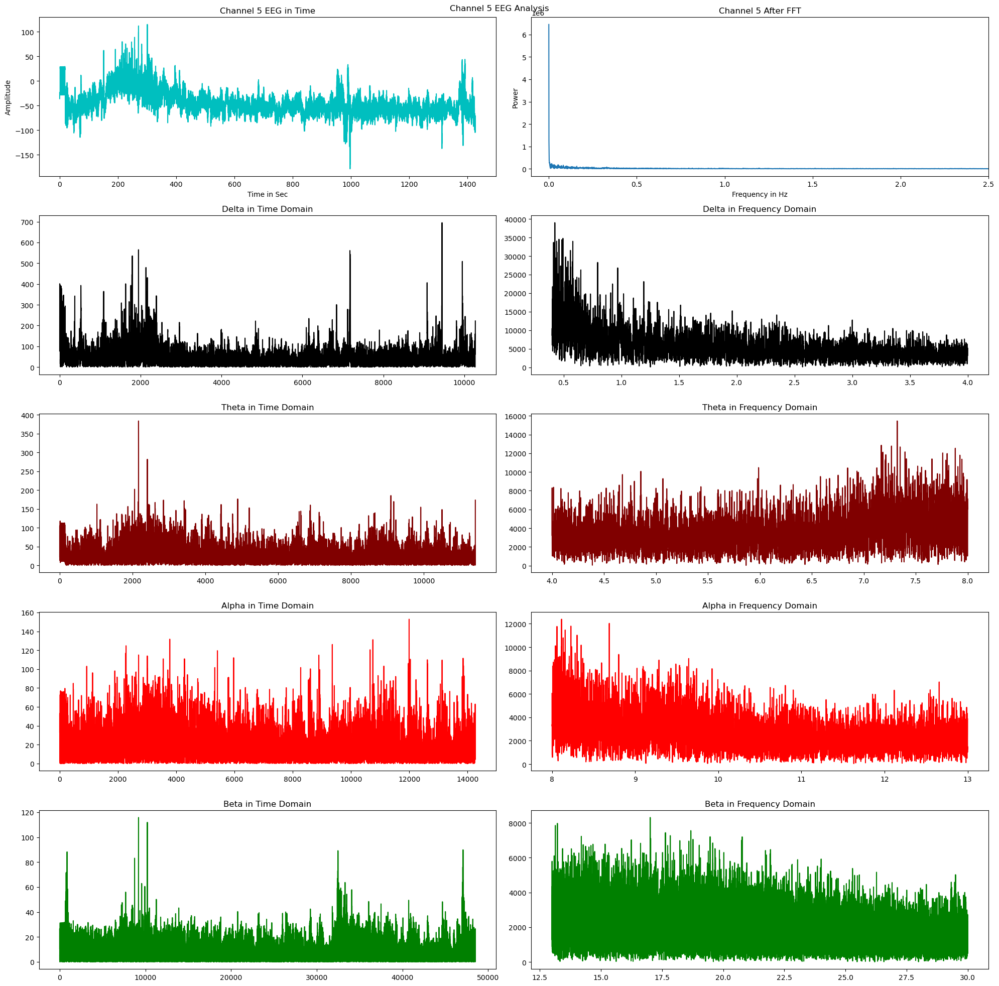

...

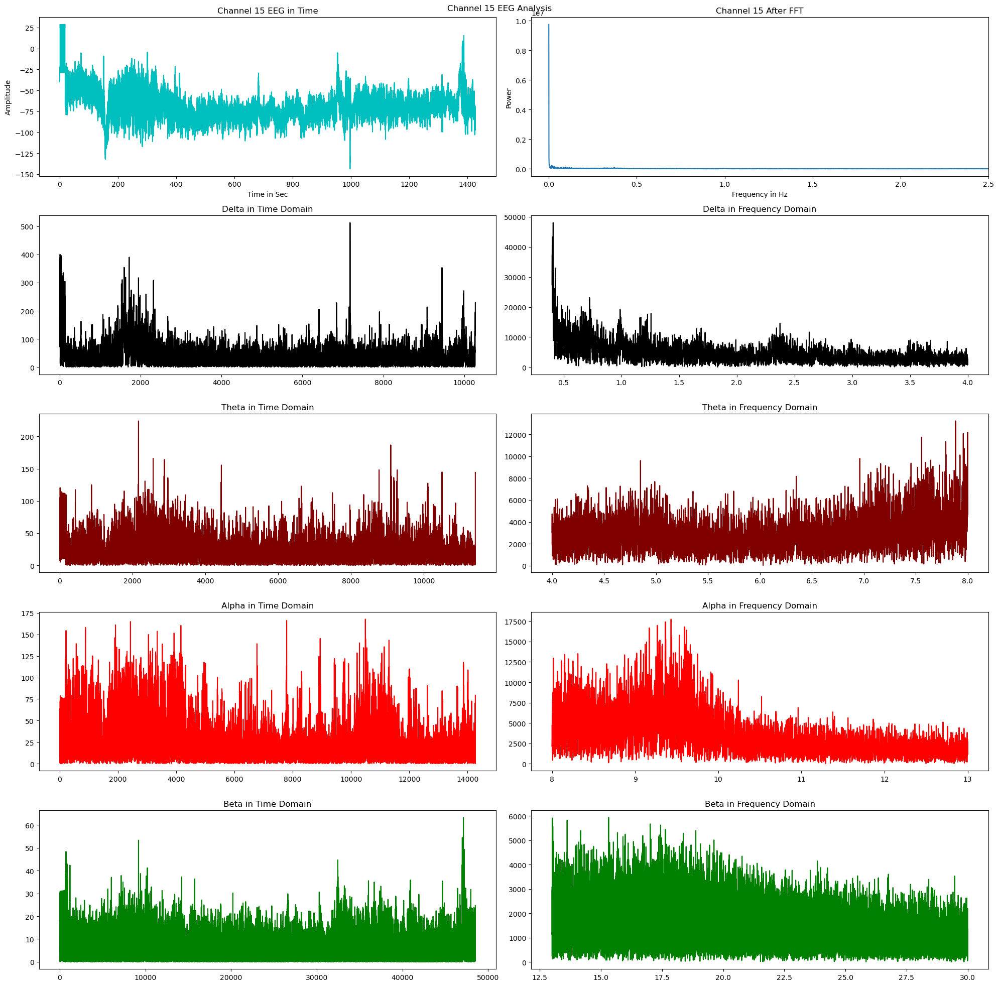

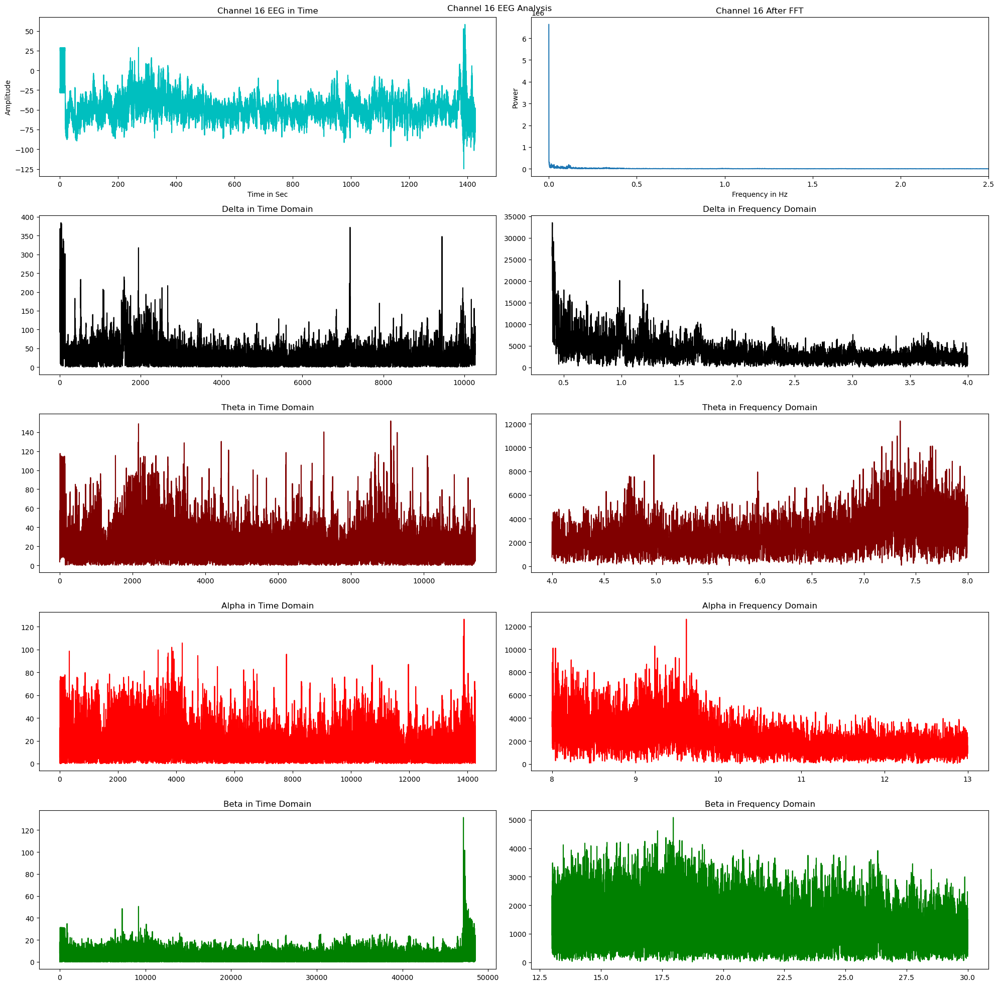

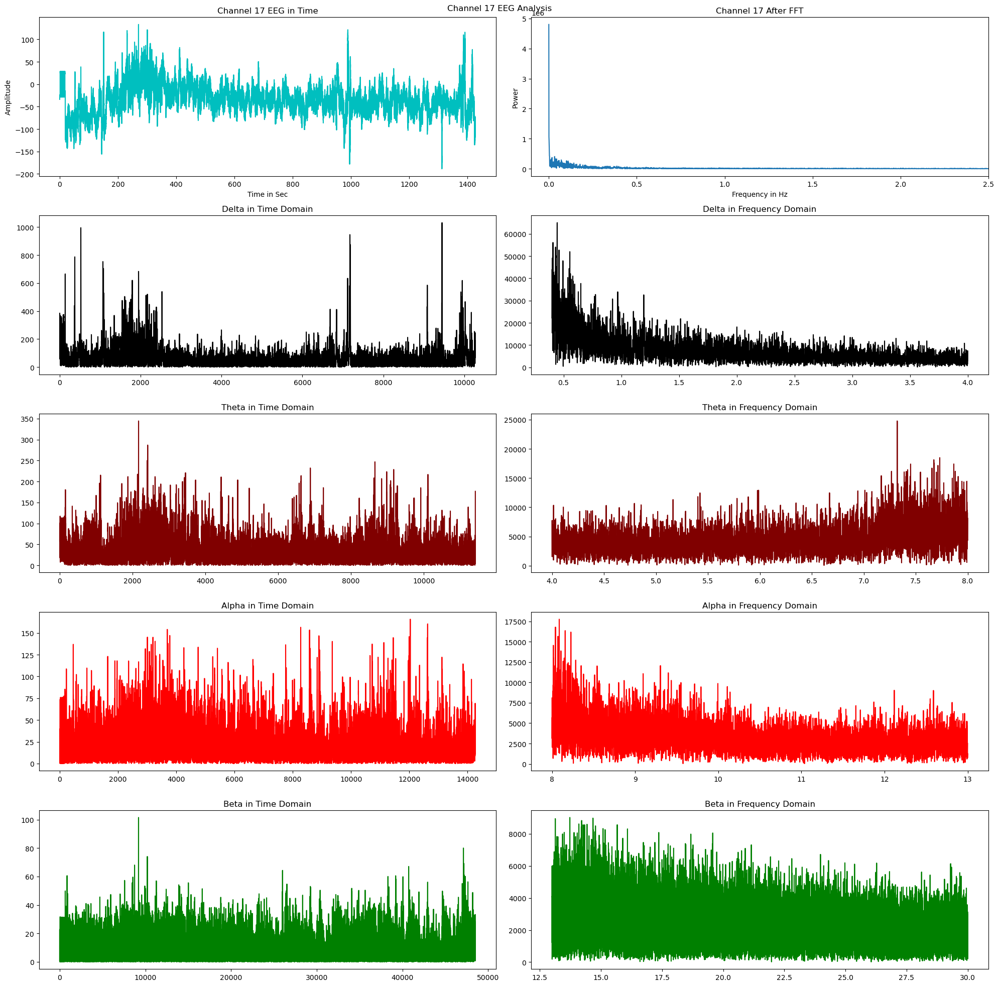

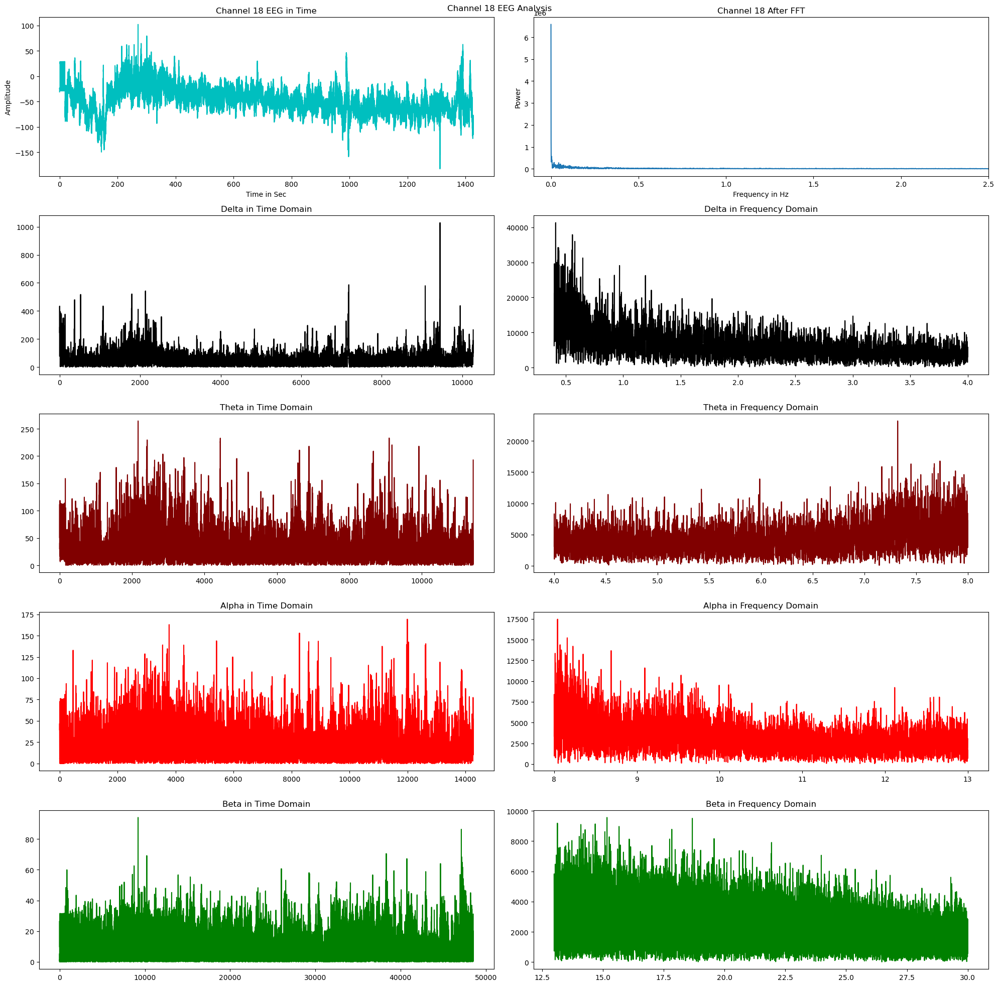

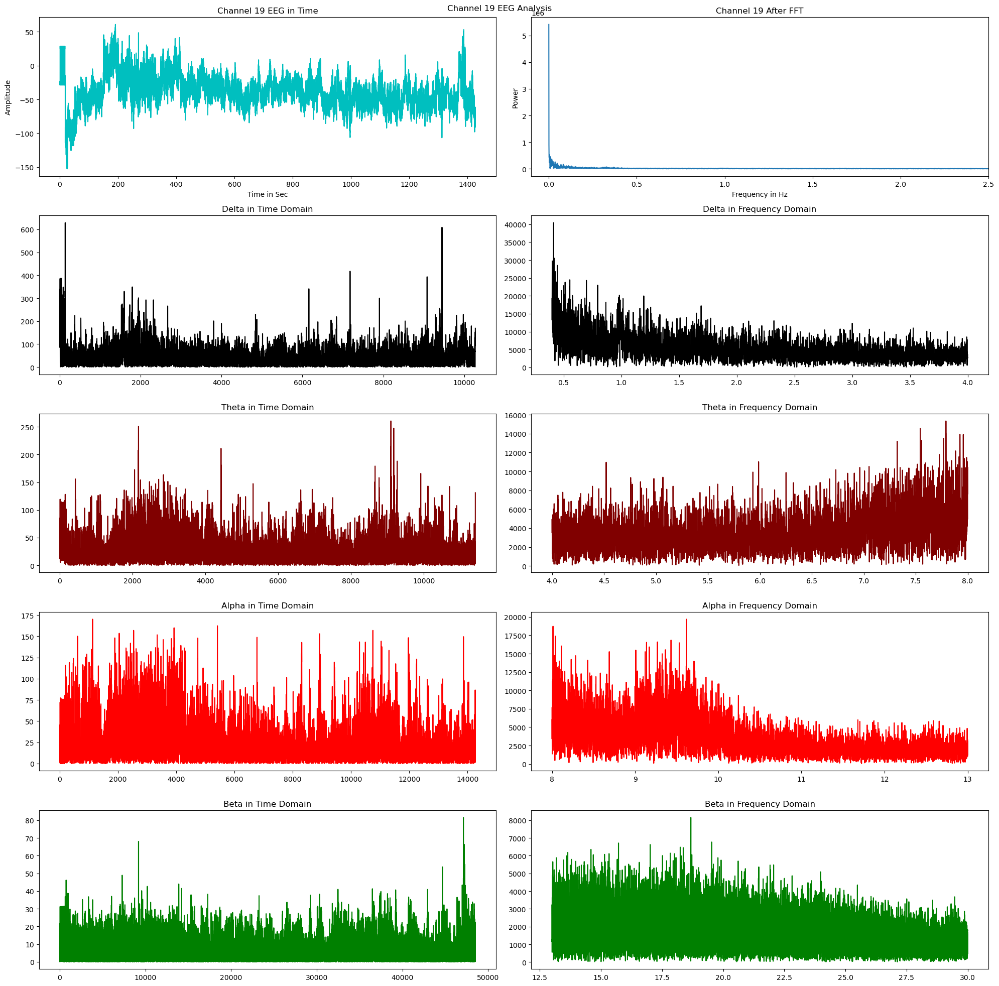

In [46]:
def plot_channel(xf, yf, channel_num):
    fig, axs = plt.subplots(5, 2, figsize=(20, 20))
    fig.suptitle(f'Channel {channel_num + 1} EEG Analysis')

    axs[0, 0].plot(time, eeg_array[channel_num, :], 'c')
    axs[0, 0].set_title(f'Channel {channel_num + 1} EEG in Time')
    axs[0, 0].set_xlabel('Time in Sec')
    axs[0, 0].set_ylabel('Amplitude')

    axs[0, 1].plot(xf, np.abs(yf))
    axs[0, 1].set_title(f'Channel {channel_num + 1} After FFT')
    axs[0, 1].set_xlabel('Frequency in Hz')
    axs[0, 1].set_ylabel('Power')
    axs[0, 1].set_xlim(-0.1, 2.5)

    colors = ['#000000', '#800000', '#FF0000', '#008000']
    
    for i, (name, low, high) in enumerate([('Delta', 0.4, 4), ('Theta', 4, 8), ('Alpha', 8, 13), ('Beta', 13, 30)]):
        freq_range = np.where((xf >= low) & (xf <= high))
        yt = np.fft.irfft(yf[freq_range])
        axs[i+1, 1].plot(xf[freq_range], np.abs(yf[freq_range]), colors[i])
        axs[i+1, 1].set_title(f'{name} in Frequency Domain')
        axs[i+1, 0].plot(np.abs(yt), colors[i])
        axs[i+1, 0].set_title(f'{name} in Time Domain')

    plt.tight_layout()
    plt.show()

# Compute FFT and plot for each channel
for i in range(num_channels):
    N = len(eeg_array[i])  # Number of signal points
    T = 1.0 / 100.0  # Sample spacing (time interval between samples)
    xf = np.fft.rfftfreq(N, T)  # Frequency values
    yf = np.fft.rfft(eeg_array[i])  # Fourier-transformed signal

    plot_channel(xf, yf, i)

In [17]:
help("numpy")

Help on package numpy:

NAME
    numpy

DESCRIPTION
    NumPy
    =====
    
    Provides
      1. An array object of arbitrary homogeneous items
      2. Fast mathematical operations over arrays
      3. Linear Algebra, Fourier Transforms, Random Number Generation
    
    How to use the documentation
    ----------------------------
    Documentation is available in two forms: docstrings provided
    with the code, and a loose standing reference guide, available from
    `the NumPy homepage <https://numpy.org>`_.
    
    We recommend exploring the docstrings using
    `IPython <https://ipython.org>`_, an advanced Python shell with
    TAB-completion and introspection capabilities.  See below for further
    instructions.
    
    The docstring examples assume that `numpy` has been imported as ``np``::
    
      >>> import numpy as np
    
    Code snippets are indicated by three greater-than signs::
    
      >>> x = 42
      >>> x = x + 1
    
    Use the built-in ``help`` functi

In [19]:
type("numpy")

str

In [20]:
np.info(np.mean)

Compute the arithmetic mean along the specified axis.

Returns the average of the array elements.  The average is taken over
the flattened array by default, otherwise over the specified axis.
`float64` intermediate and return values are used for integer inputs.

Parameters
----------
a : array_like
    Array containing numbers whose mean is desired. If `a` is not an
    array, a conversion is attempted.
axis : None or int or tuple of ints, optional
    Axis or axes along which the means are computed. The default is to
    compute the mean of the flattened array.

    .. versionadded:: 1.7.0

    If this is a tuple of ints, a mean is performed over multiple axes,
    instead of a single axis or all the axes as before.
dtype : data-type, optional
    Type to use in computing the mean.  For integer inputs, the default
    is `float64`; for floating point inputs, it is the same as the
    input dtype.
out : ndarray, optional
    Alternate output array in which to place the result.  The def

In [25]:
import scipy as scipy

In [26]:
print(dir(scipy))

['LowLevelCallable', '__version__', 'cluster', 'constants', 'datasets', 'fft', 'fftpack', 'integrate', 'interpolate', 'io', 'linalg', 'misc', 'ndimage', 'odr', 'optimize', 'show_config', 'signal', 'sparse', 'spatial', 'special', 'stats', 'test']


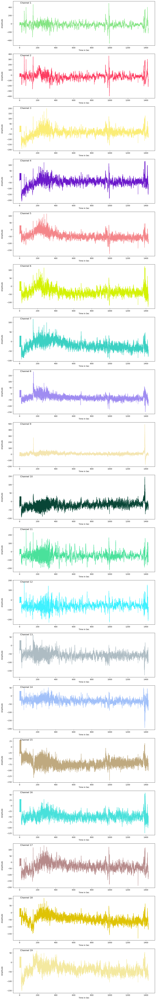

In [47]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Load EEG data into a NumPy array
eeg_array = np.load('/home/nalin/Downloads/eeg_data_files-20240411/66_00002251_none_montage_False.npy')

# Get number of channels and time points
num_channels, num_time_points = eeg_array.shape
time = np.arange(num_time_points) / 100.0

# Create DataFrame for EEG data
eeg_df = pd.DataFrame(eeg_array.T, columns=[f'Channel {i+1}' for i in range(num_channels)])

# Plot EEG data for each channel
fig, axs = plt.subplots(num_channels, 1, figsize=(12, 4 * num_channels))
for channel in range(num_channels):
    axs[channel].plot(time, eeg_df[f'Channel {channel + 1}'], c=np.random.rand(3))
    axs[channel].set_ylabel(f'Amplitude', labelpad=20)
    axs[channel].set_xlabel('Time in Sec')
    axs[channel].text(0.05, 0.95, f'Channel {channel + 1}', transform=axs[channel].transAxes, fontsize=12)
plt.tight_layout()
plt.show()


In [48]:
eeg_df

,Channel 1,Channel 2,Channel 3,Channel 4,Channel 5,Channel 6,Channel 7,Channel 8,Channel 9,Channel 10,Channel 11,Channel 12,Channel 13,Channel 14,Channel 15,Channel 16,Channel 17,Channel 18,Channel 19
0,-48.390946,-37.066100,-30.927481,-37.625620,-36.140306,-24.139144,-22.910891,-28.811240,-9.276270,5.941499,-47.356291,-32.951912,-47.883929,-25.113793,-39.679531,-27.694969,-33.711284,-30.883738,-28.078636
1,-20.339197,-23.502271,-24.780242,-23.821606,-23.778912,-28.740505,-27.655096,-25.945963,-30.818397,-37.100017,-20.093808,-24.782470,-19.119481,-25.622731,-22.187659,-26.280086,-24.947808,-26.554084,-25.961302
2,-26.844545,-25.175713,-24.504494,-24.734113,-24.977796,-21.626152,-22.742680,-23.678172,-21.069710,-17.203217,-27.171847,-24.272316,-27.918570,-24.137912,-26.016894,-23.496837,-24.199319,-23.110050,-23.802788
3,-23.792625,-24.839514,-25.299538,-25.304536,-25.004137,-27.587680,-26.561259,-25.942494,-27.683163,-30.402420,-23.465944,-25.610759,-22.879045,-25.579096,-24.239300,-26.055954,-25.587072,-26.398544,-25.777907
4,-25.522347,-24.810357,-24.455930,-24.352087,-24.666642,-22.545412,-23.477262,-23.929440,-22.635389,-20.575875,-25.835122,-24.102633,-26.313238,-24.179413,-25.267033,-23.852691,-24.200845,-23.560624,-24.102492
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142695,-136.931310,-105.653205,-75.230357,-93.601078,-94.081652,-72.956824,-59.116087,-61.793301,-1.753429,-20.711627,-123.851206,-85.855825,-105.887566,-39.776959,-82.819381,-54.238131,-102.065733,-103.423229,-74.065838
142696,-122.790297,-90.860902,-69.416004,-72.826265,-93.372107,-64.363448,-61.865791,-63.211328,-6.550145,-25.699078,-115.368968,-92.654734,-97.910381,-30.316077,-81.990388,-50.763977,-91.814302,-99.110730,-75.378208
142697,-120.866779,-84.737118,-55.916280,-65.625539,-88.802352,-62.557760,-62.972269,-66.764269,-9.148662,-28.667714,-113.739305,-80.316529,-104.988512,-37.271570,-91.987504,-56.987191,-78.115956,-87.845623,-80.161078
142698,-111.827482,-84.617948,-51.139309,-67.158561,-79.284750,-55.729181,-53.735172,-58.961108,-7.051634,-30.506701,-101.646598,-76.609590,-94.777481,-34.473103,-85.181595,-53.099085,-73.122176,-82.359328,-69.998335


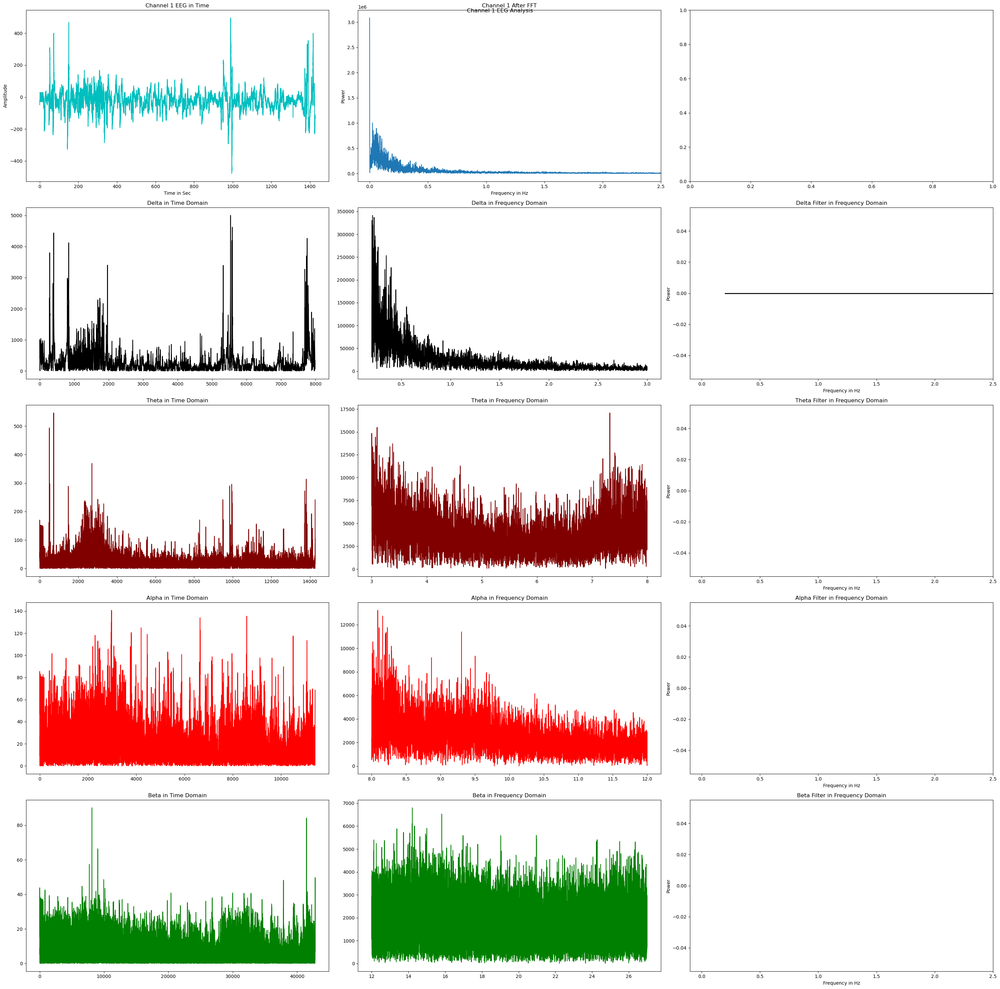

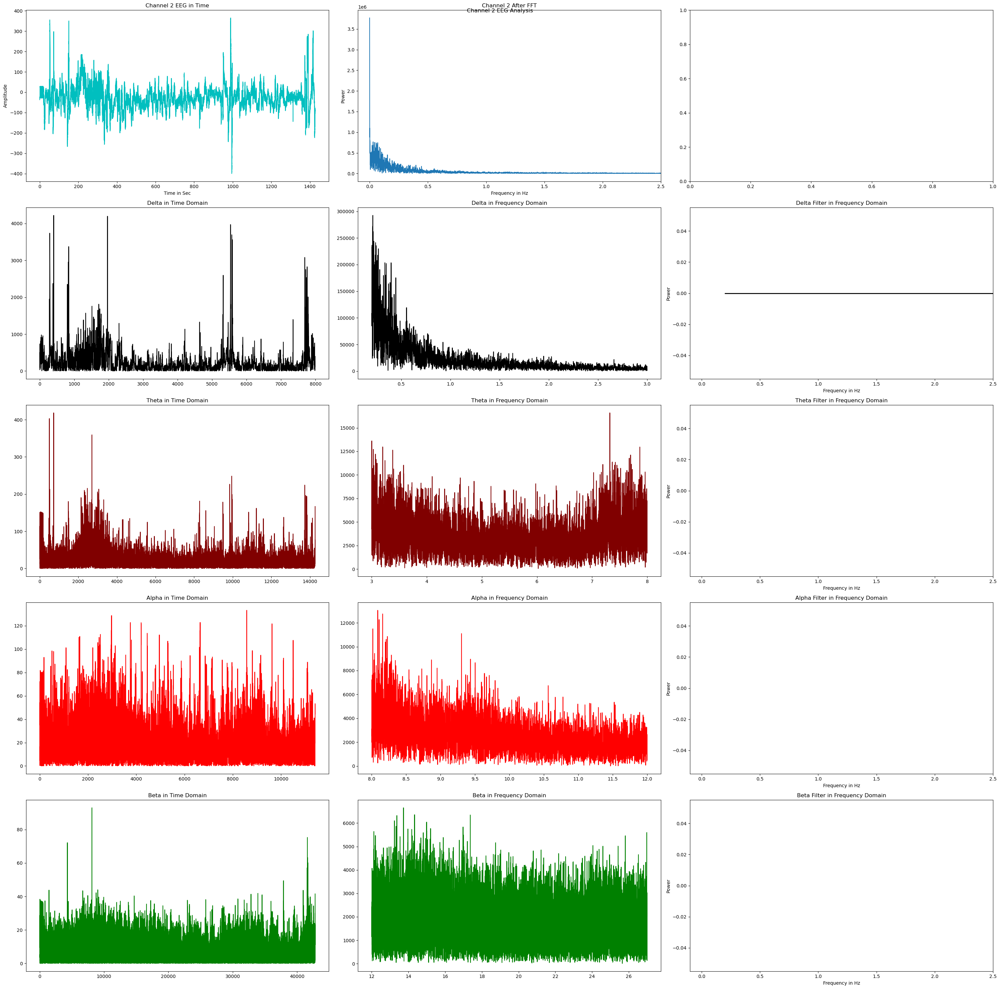

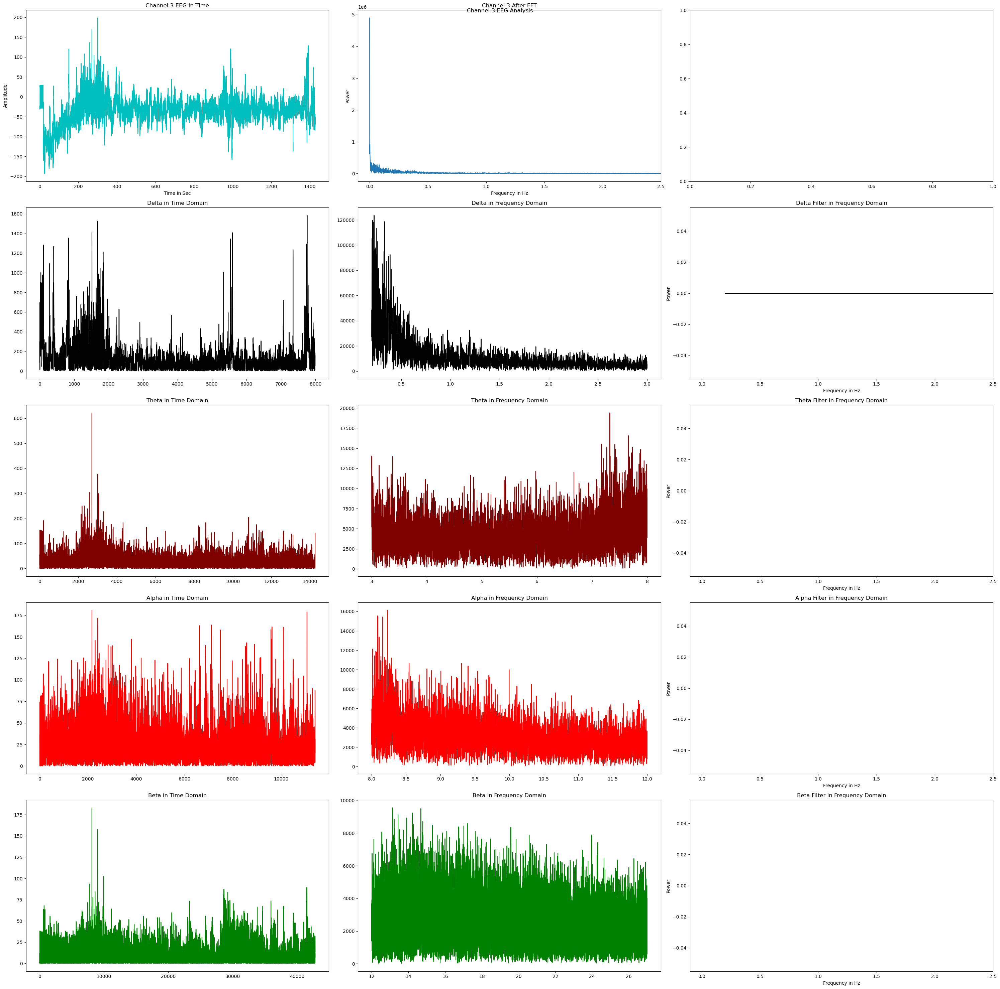

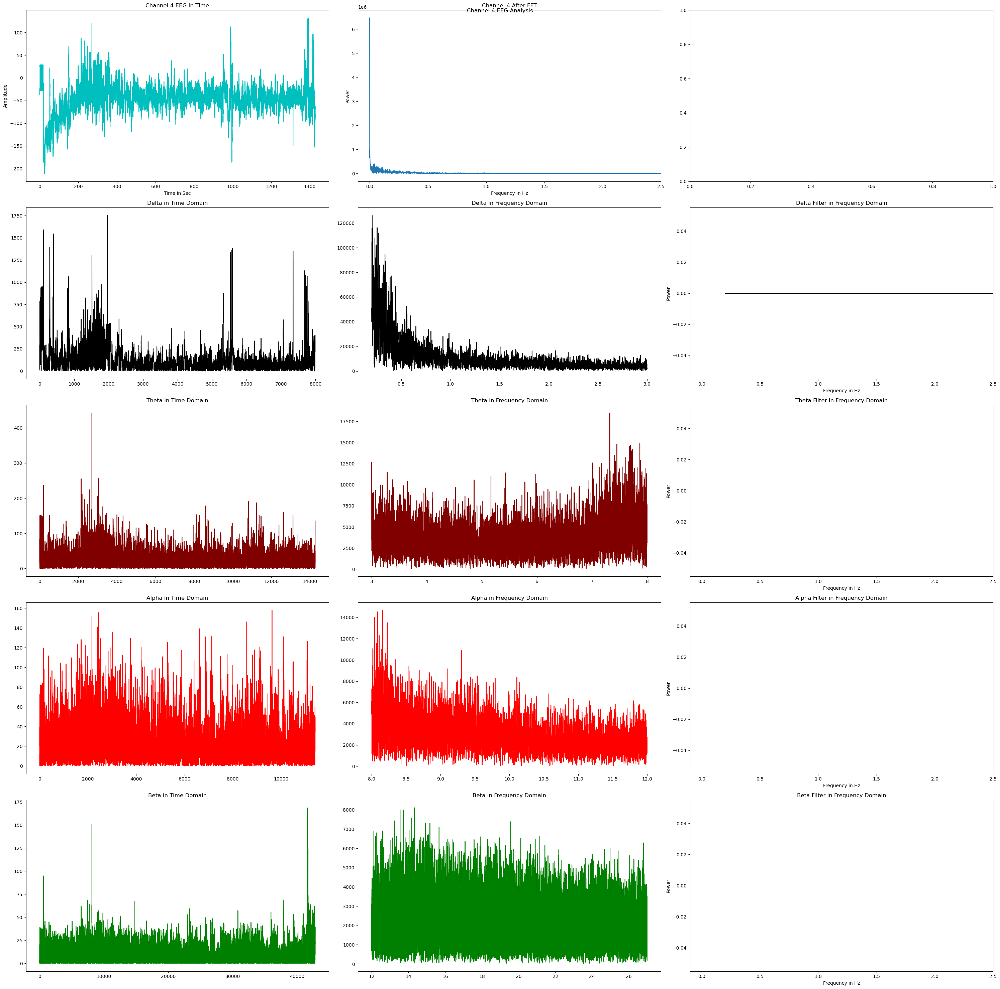

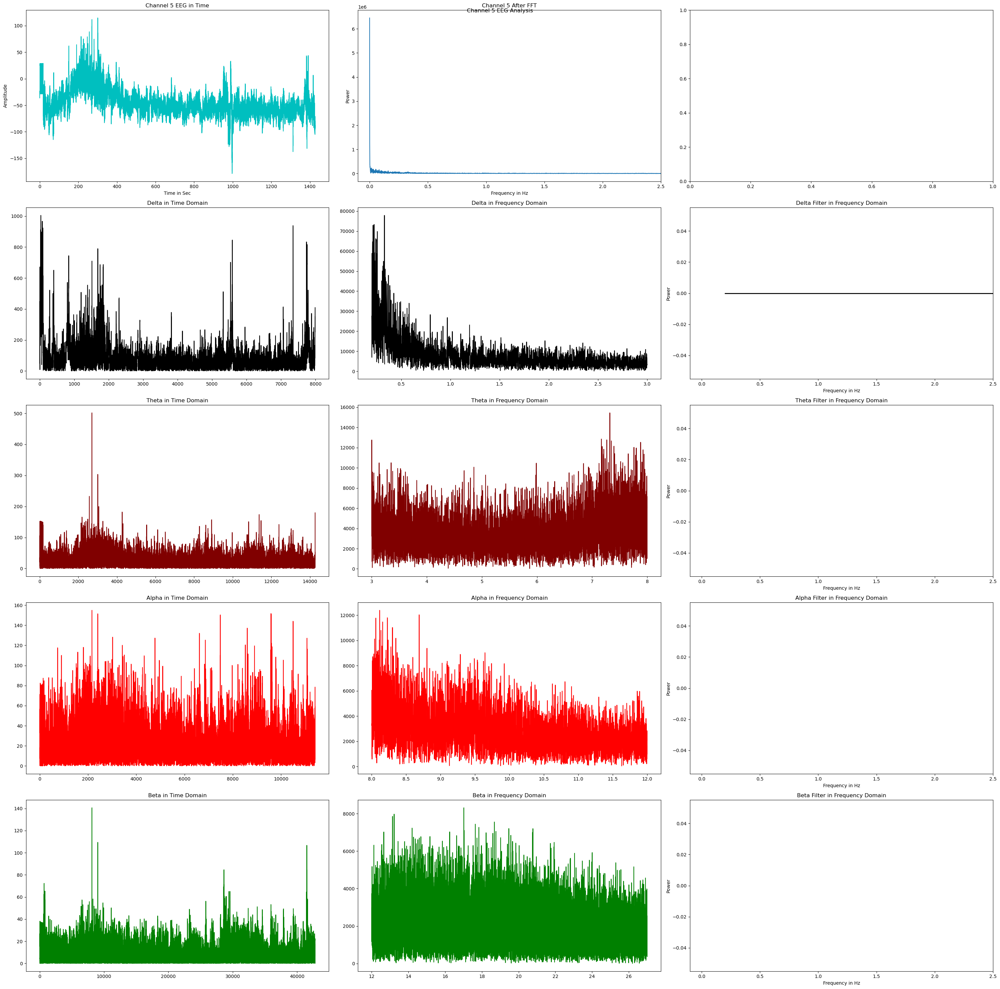

...

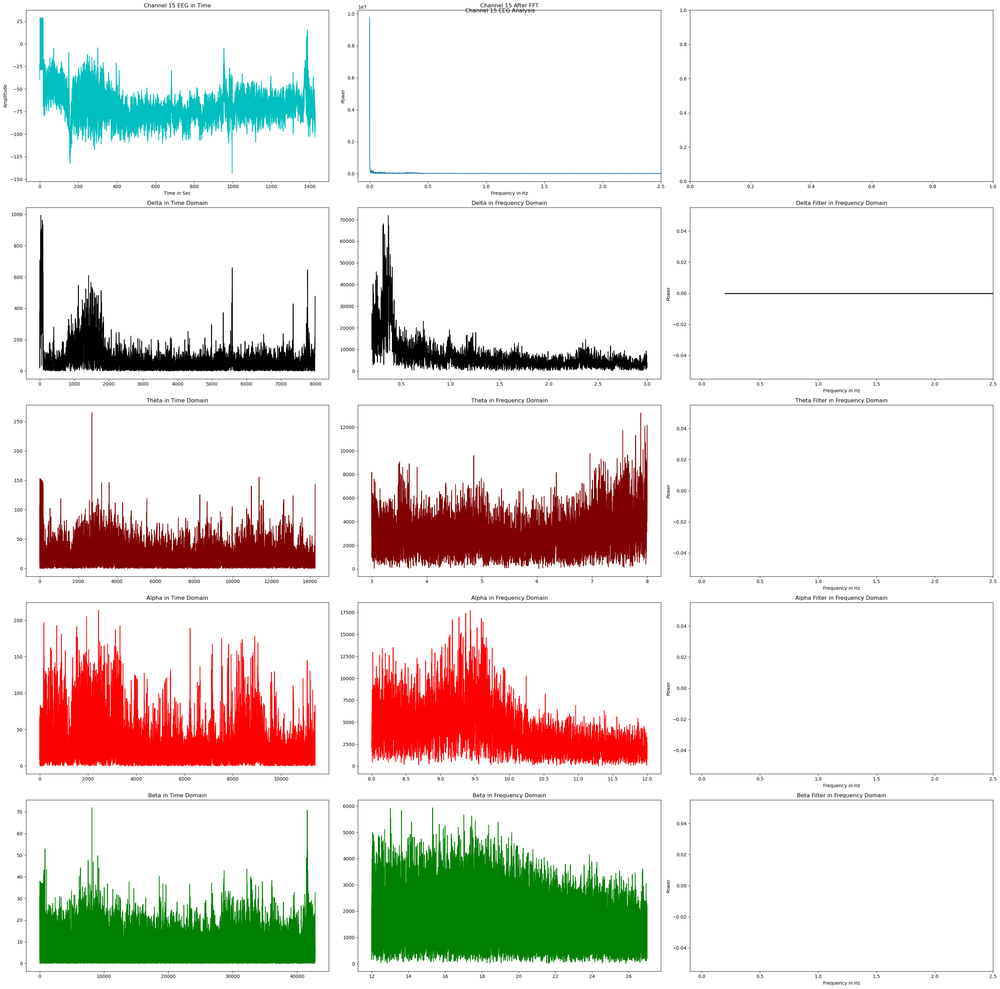

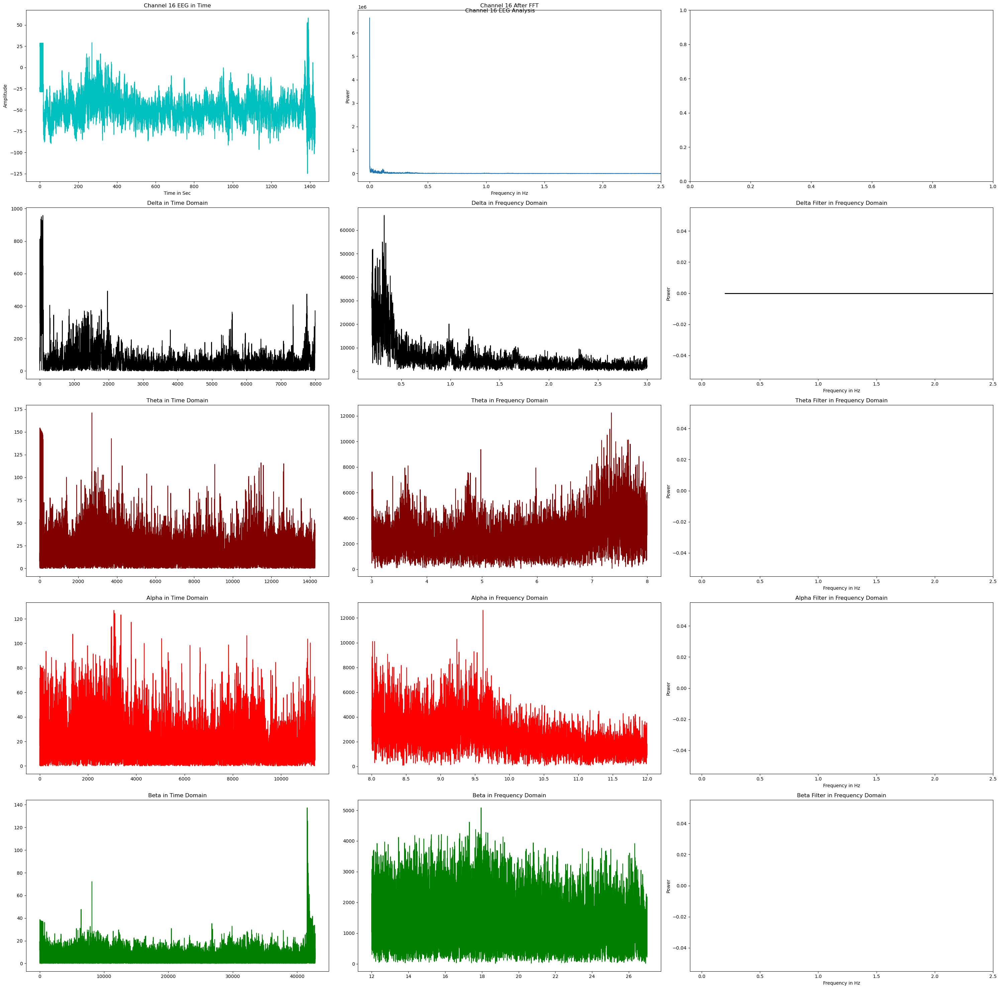

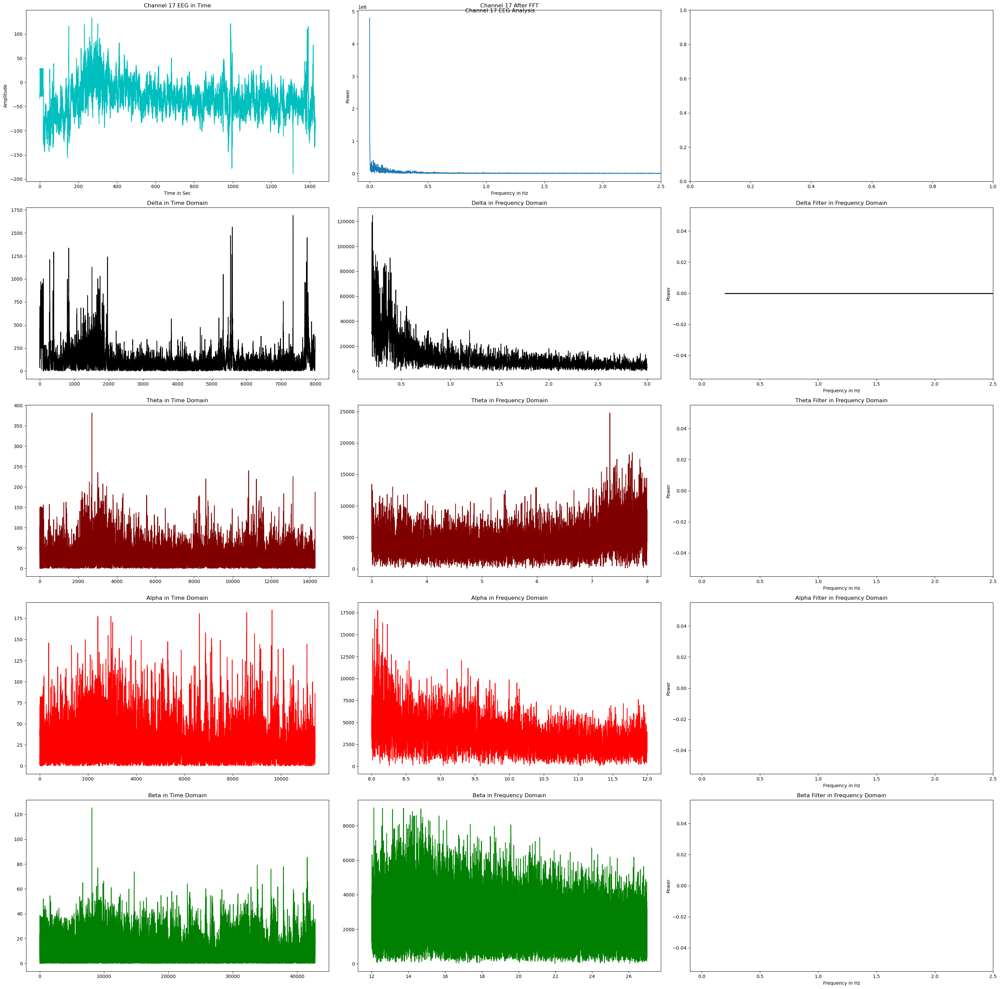

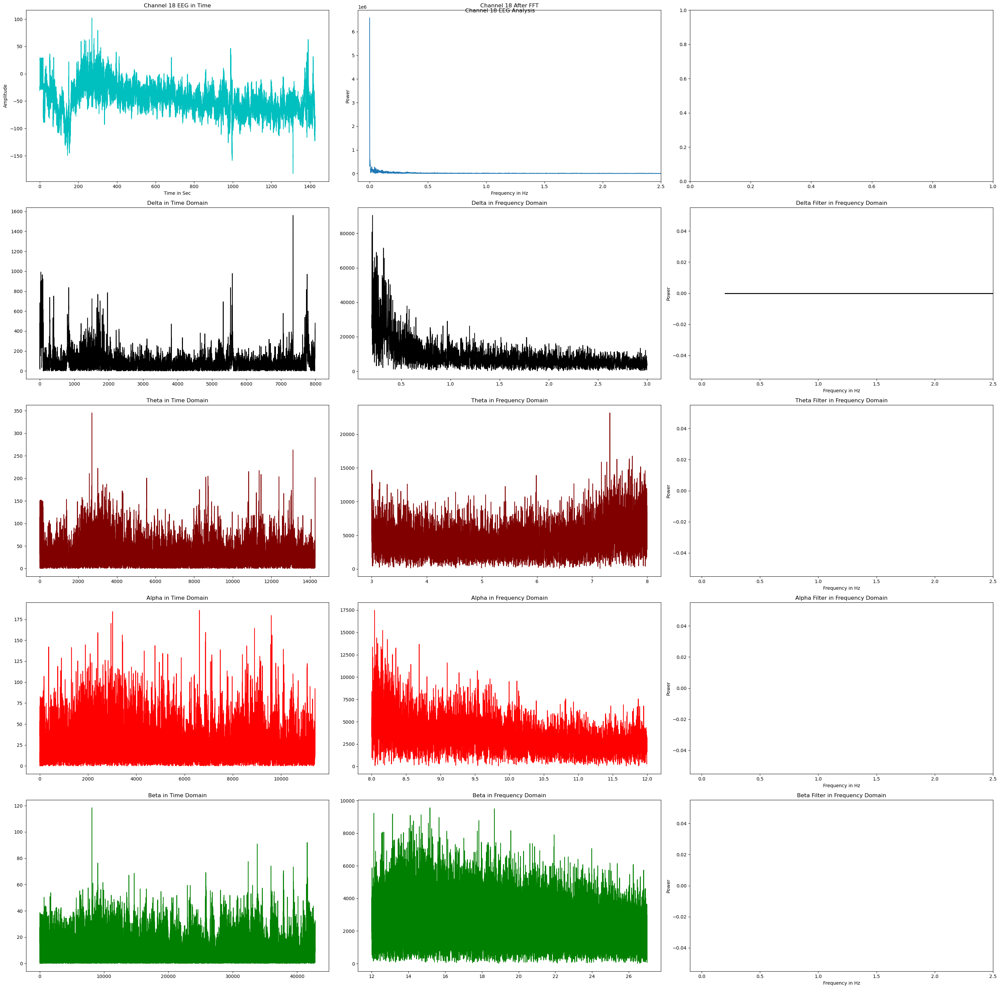

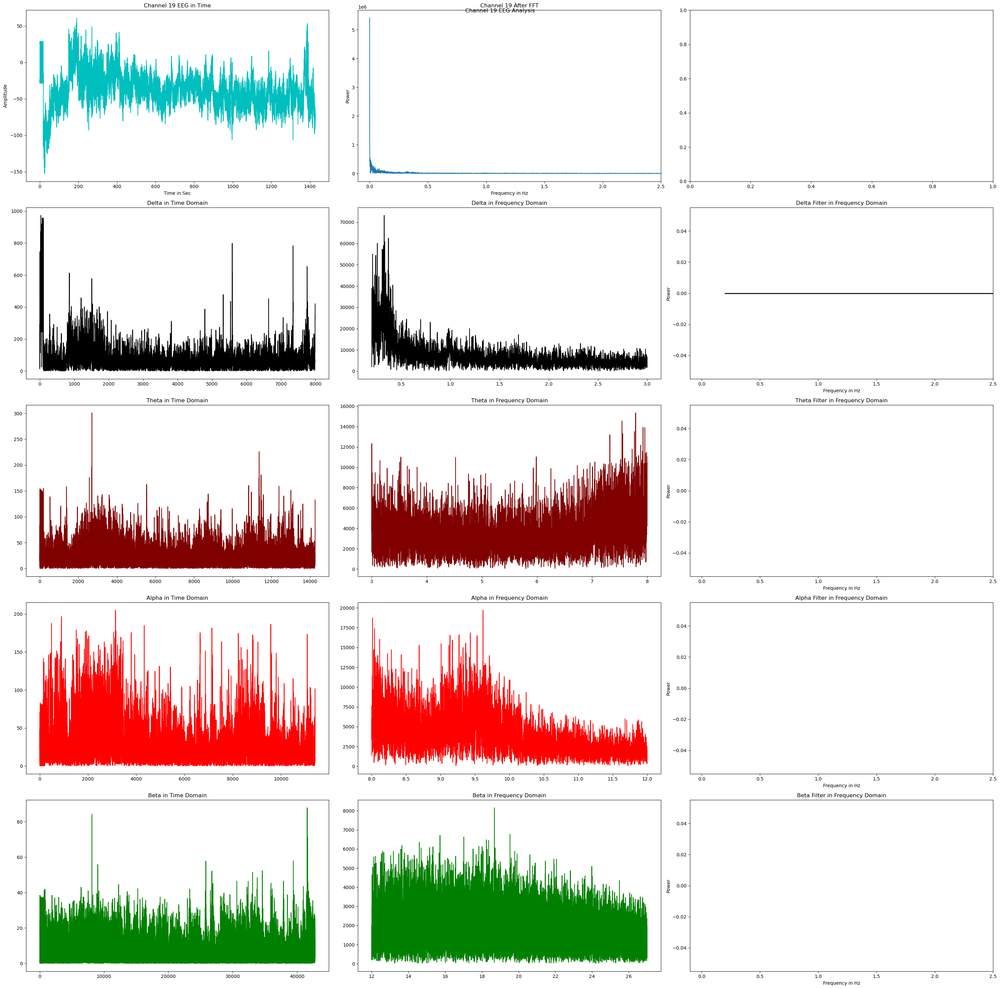

In [37]:
import numpy as np
import matplotlib.pyplot as plt

def plot_channel(xf, yf, channel_num, colors):
    fig, axs = plt.subplots(5, 3, figsize=(30, 30))
    fig.suptitle(f'Channel {channel_num + 1} EEG Analysis')

    axs[0, 0].plot(time, eeg_array[channel_num, :], 'c')
    axs[0, 0].set_title(f'Channel {channel_num + 1} EEG in Time')
    axs[0, 0].set_xlabel('Time in Sec')
    axs[0, 0].set_ylabel('Amplitude')

    axs[0, 1].plot(xf, np.abs(yf))
    axs[0, 1].set_title(f'Channel {channel_num + 1} After FFT')
    axs[0, 1].set_xlabel('Frequency in Hz')
    axs[0, 1].set_ylabel('Power')
    axs[0, 1].set_xlim(-0.1, 2.5)

    for i, (name, low, high) in enumerate([('Delta', 0.2, 3), ('Theta', 3, 8), ('Alpha', 8, 12), ('Beta', 12, 27)]):
        freq_range = np.where((xf >= low) & (xf <= high))
        yt = np.fft.irfft(yf[freq_range])
        axs[i+1, 1].plot(xf[freq_range], np.abs(yf[freq_range]), colors[i])
        axs[i+1, 1].set_title(f'{name} in Frequency Domain')
        axs[i+1, 0].plot(np.abs(yt), colors[i])
        axs[i+1, 0].set_title(f'{name} in Time Domain')

        # Plot filters in frequency domain
        axs[i+1, 2].plot([low, high], [0, 0], colors[i], linewidth=2, label=name)
        axs[i+1, 2].set_title(f'{name} Filter in Frequency Domain')
        axs[i+1, 2].set_xlabel('Frequency in Hz')
        axs[i+1, 2].set_ylabel('Power')
        axs[i+1, 2].set_xlim(-0.1, 2.5)

    plt.tight_layout()
    plt.show()

# Compute FFT and plot for each channel
colors = ['#000000', '#800000', '#FF0000', '#008000']
for i in range(num_channels):
    N = len(eeg_array[i])  # Number of signal points
    T = 1.0 / 100.0  # Sample spacing (time interval between samples)
    xf = np.fft.rfftfreq(N, T)  # Frequency values
    yf = np.fft.rfft(eeg_array[i])  # Fourier-transformed signal

    plot_channel(xf, yf, i, colors)

In [39]:
# Example filter data
# Assuming low_pass_filter_data and high_pass_filter_data are arrays representing the frequency response of your filters
# You need to replace these arrays with your actual filter data

# Generate example low-pass filter data
low_pass_cutoff_freq = 30  # Specify the cutoff frequency of your low-pass filter
low_pass_filter_data = np.zeros_like(xf)
low_pass_filter_data[xf <= low_pass_cutoff_freq] = 1

# Generate example high-pass filter data
high_pass_cutoff_freq = 1  # Specify the cutoff frequency of your high-pass filter
high_pass_filter_data = np.zeros_like(xf)
high_pass_filter_data[xf >= high_pass_cutoff_freq] = 1

# Define your filters
filters = {
    'Low Pass': (xf, low_pass_filter_data),
    'High Pass': (xf, high_pass_filter_data),
    # Add more filters as needed
}


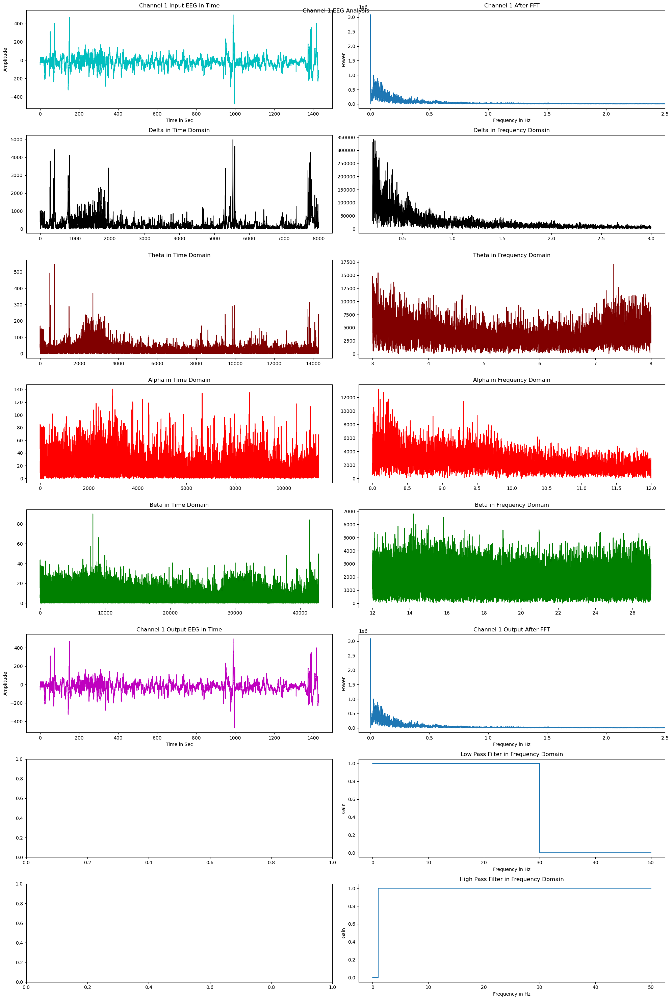

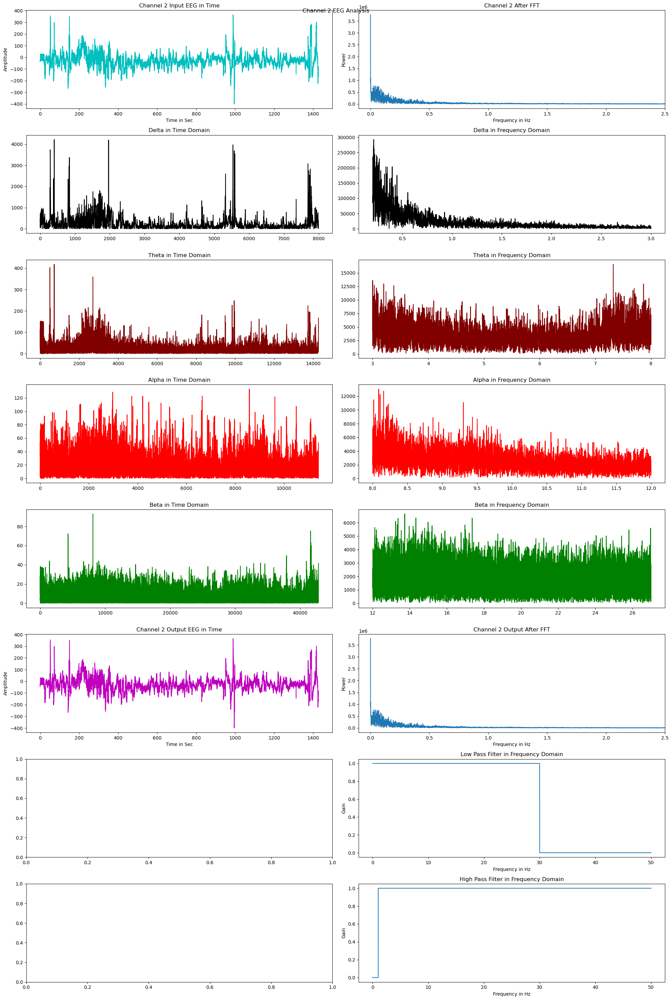

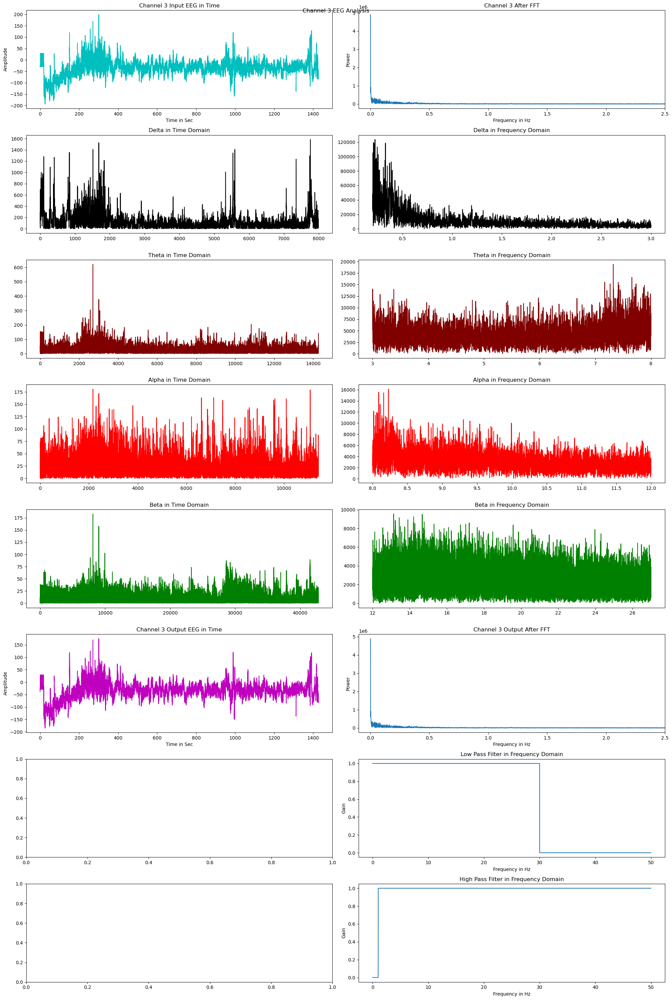

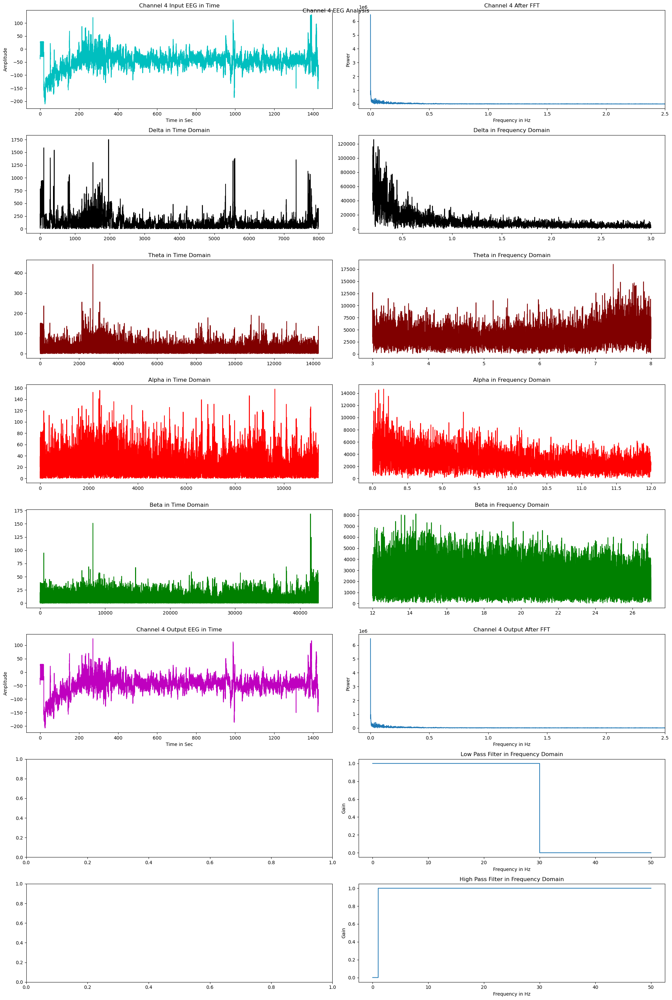

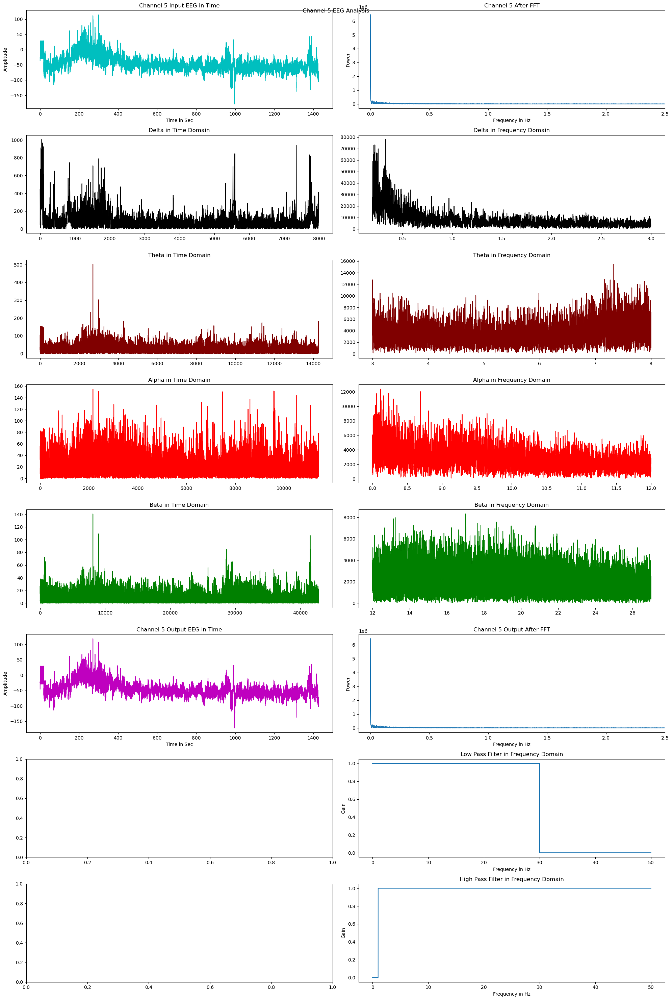

...

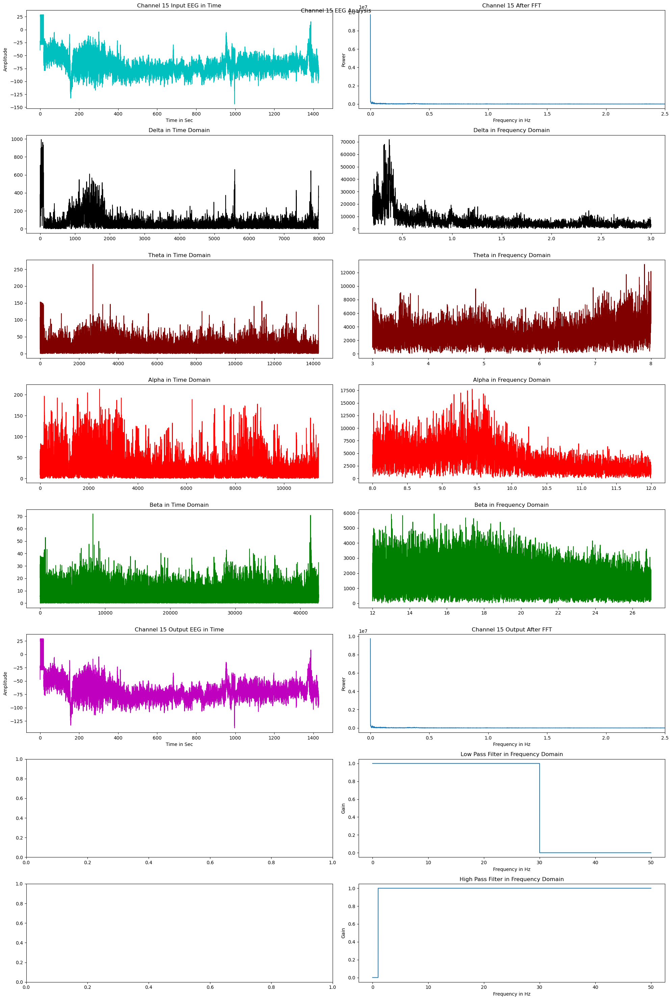

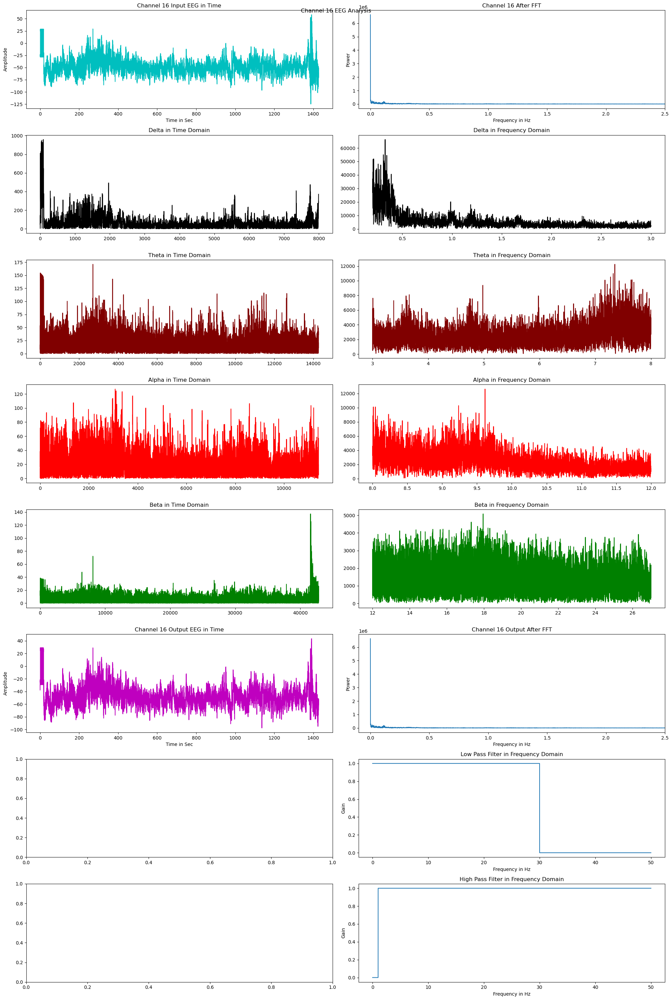

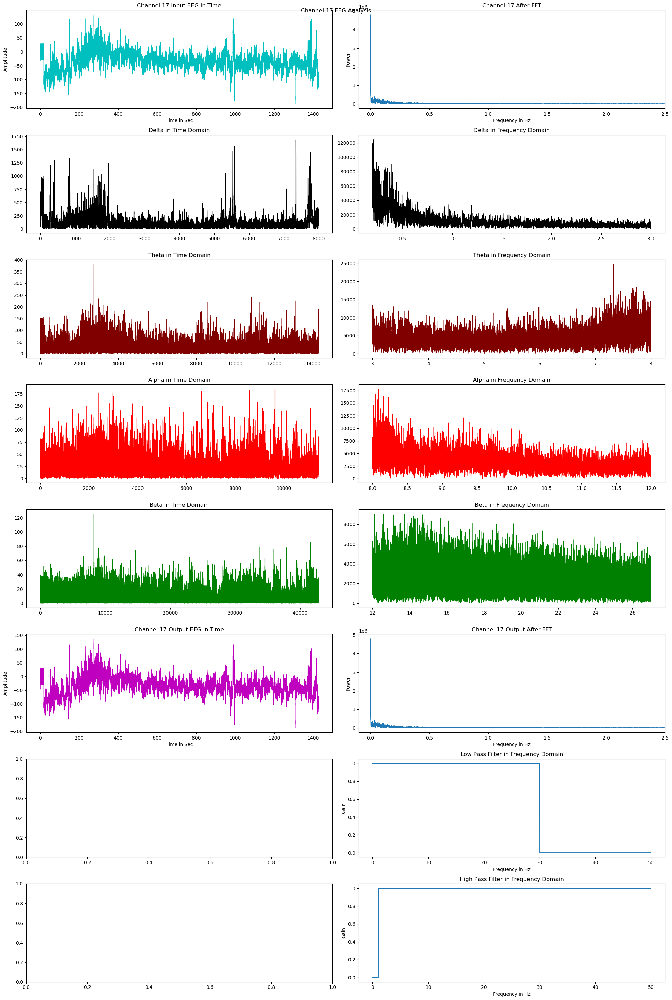

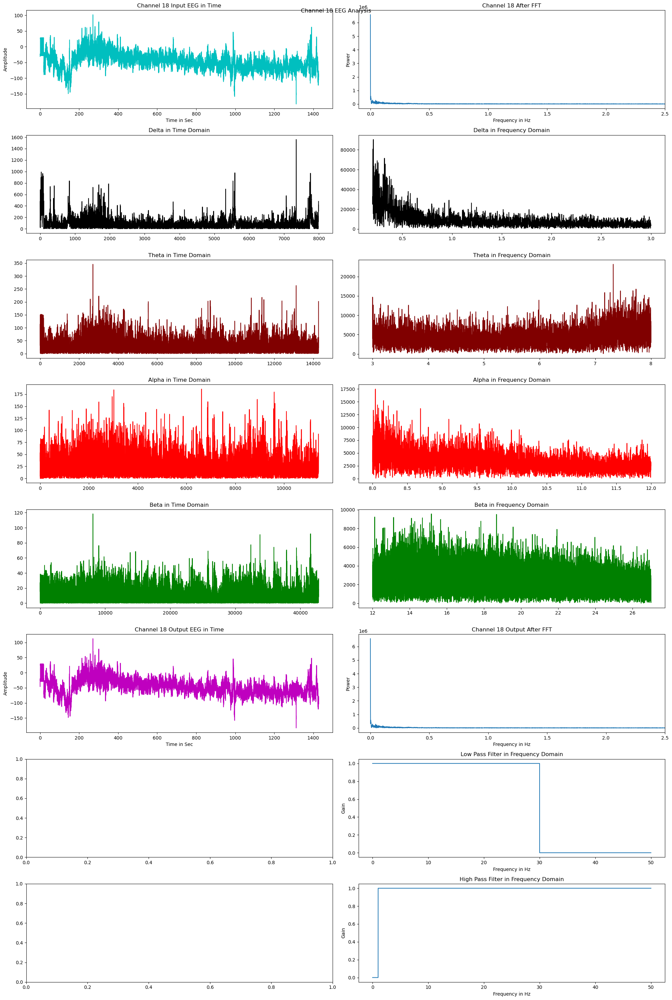

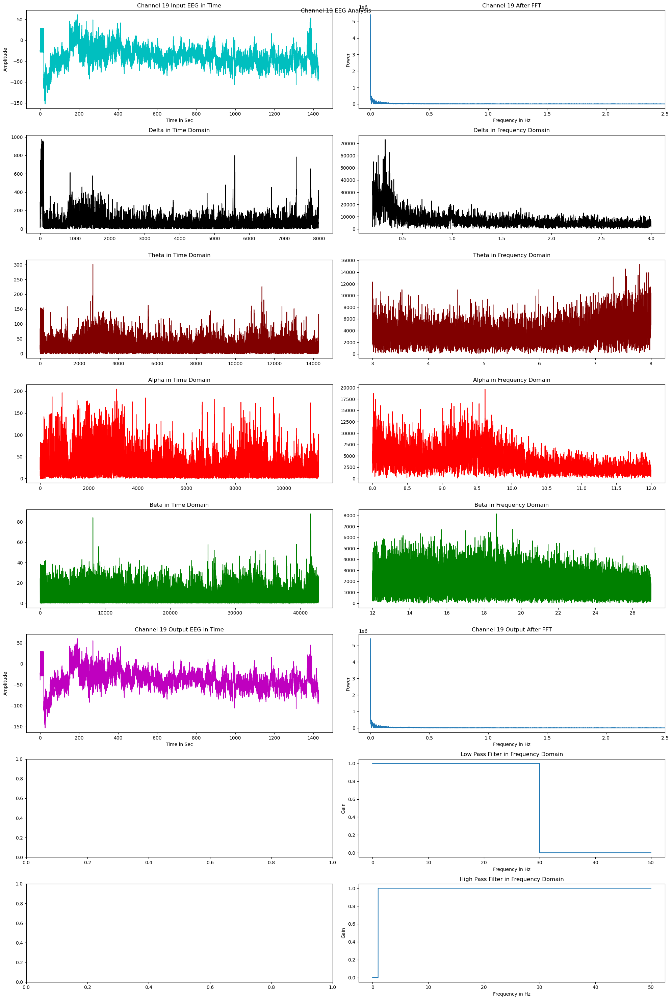

In [40]:
import numpy as np
import matplotlib.pyplot as plt

def plot_channel(xf, yf, channel_num, input_signal, output_signal, filters=None):
    fig, axs = plt.subplots(8, 2, figsize=(20, 30))
    fig.suptitle(f'Channel {channel_num + 1} EEG Analysis')

    axs[0, 0].plot(time, input_signal, 'c')
    axs[0, 0].set_title(f'Channel {channel_num + 1} Input EEG in Time')
    axs[0, 0].set_xlabel('Time in Sec')
    axs[0, 0].set_ylabel('Amplitude')

    axs[0, 1].plot(xf, np.abs(yf))
    axs[0, 1].set_title(f'Channel {channel_num + 1} After FFT')
    axs[0, 1].set_xlabel('Frequency in Hz')
    axs[0, 1].set_ylabel('Power')
    axs[0, 1].set_xlim(-0.1, 2.5)

    colors = ['#000000', '#800000', '#FF0000', '#008000']
    
    for i, (name, low, high) in enumerate([('Delta', 0.2, 3), ('Theta', 3, 8), ('Alpha', 8, 12), ('Beta', 12, 27)]):
        freq_range = np.where((xf >= low) & (xf <= high))
        yt = np.fft.irfft(yf[freq_range])
        axs[i+1, 1].plot(xf[freq_range], np.abs(yf[freq_range]), colors[i])
        axs[i+1, 1].set_title(f'{name} in Frequency Domain')
        axs[i+1, 0].plot(np.abs(yt), colors[i])
        axs[i+1, 0].set_title(f'{name} in Time Domain')

    axs[5, 0].plot(time, output_signal, 'm')
    axs[5, 0].set_title(f'Channel {channel_num + 1} Output EEG in Time')
    axs[5, 0].set_xlabel('Time in Sec')
    axs[5, 0].set_ylabel('Amplitude')

    axs[5, 1].plot(xf, np.abs(np.fft.rfft(output_signal)))
    axs[5, 1].set_title(f'Channel {channel_num + 1} Output After FFT')
    axs[5, 1].set_xlabel('Frequency in Hz')
    axs[5, 1].set_ylabel('Power')
    axs[5, 1].set_xlim(-0.1, 2.5)

    # Plot filters if provided
    if filters is not None:
        for i, (name, filter_data) in enumerate(filters.items()):
            axs[6+i, 1].plot(filter_data[0], np.abs(filter_data[1]), label=name)
            axs[6+i, 1].set_title(f'{name} Filter in Frequency Domain')
            axs[6+i, 1].set_xlabel('Frequency in Hz')
            axs[6+i, 1].set_ylabel('Gain')

    plt.tight_layout()
    plt.show()

# Assuming you have defined num_channels, time, and eeg_array
# Define your filters, for example:
filters = {
    'Low Pass': (xf, low_pass_filter_data),  # low_pass_filter_data contains your filter response
    'High Pass': (xf, high_pass_filter_data),  # high_pass_filter_data contains your filter response
    # Add more filters as needed
}

# Compute FFT and plot for each channel
for i in range(num_channels):
    N = len(eeg_array[i])  # Number of signal points
    T = 1.0 / 100.0  # Sample spacing (time interval between samples)
    xf = np.fft.rfftfreq(N, T)  # Frequency values
    yf = np.fft.rfft(eeg_array[i])  # Fourier-transformed signal

    # Assuming you have input and output signals for each channel
    input_signal = eeg_array[i]
    
    # Apply some processing or filtering to get the output signal
    # For example, you can filter the input signal using your defined filters
    output_signal = np.fft.irfft(yf * low_pass_filter_data)  # Example: apply low-pass filter

    plot_channel(xf, yf, i, input_signal, output_signal, filters)
